In [ ]:
# import tensorflow_datasets as tfds
import tensorflow as tf
from tensorflow.keras import layers

In [ ]:
print(f"TensorFlow version {tf.__version__}")

device_name = tf.test.gpu_device_name()
if not device_name:
  print('GPU device not found')
else:
  !nvidia-smi

TensorFlow version 2.6.0
Mon Oct  4 00:41:15 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.74       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   43C    P0    38W / 250W |    345MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                               

In [ ]:
# !pip install Tensorflow-GPU==2.4.1

In [ ]:
import os
from glob import glob
from PIL import Image
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import time

In [ ]:
!mkdir data

In [ ]:
!mkdir data/images

In [ ]:
!wget https://s3-us-west-2.amazonaws.com/imagenetv2public/imagenetv2-matched-frequency.tar.gz

--2021-10-04 00:41:26--  https://s3-us-west-2.amazonaws.com/imagenetv2public/imagenetv2-matched-frequency.tar.gz
Resolving s3-us-west-2.amazonaws.com (s3-us-west-2.amazonaws.com)... 52.92.161.40
Connecting to s3-us-west-2.amazonaws.com (s3-us-west-2.amazonaws.com)|52.92.161.40|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1264079360 (1.2G) [application/x-tar]
Saving to: ‘imagenetv2-matched-frequency.tar.gz’

imagenetv2-matched- 100%[===================>]   1.18G  22.2MB/s    in 56s     

2021-10-04 00:42:23 (21.6 MB/s) - ‘imagenetv2-matched-frequency.tar.gz’ saved [1264079360/1264079360]



In [ ]:
!tar -xf imagenetv2-matched-frequency.tar.gz -C data

In [ ]:
original_path = "data/imagenetv2-matched-frequency-format-val"

In [ ]:
directories = os.listdir(original_path)

In [ ]:
len(directories)

1000

In [ ]:
complete_images_paths = []
not_rgb_images = []
image_height = []
image_width = []

In [ ]:
for directory in directories:
  image_paths = glob(f"{original_path}/{directory}/*")

  for image_path in image_paths:
    image = Image.open(image_path)

    if image.mode == "RGB":
      complete_images_paths.append(image_path)
      size = image.size
      image_width.append(size[0])
      image_height.append(size[1])
    else:
      not_rgb_images.append(image_path)

In [ ]:
len(complete_images_paths)

10000

In [ ]:
data_dict = {
    "path": complete_images_paths,
    "height": image_height,
    "width": image_width
}

In [ ]:
data_frame = pd.DataFrame.from_dict(data_dict)

### Examples

In [ ]:
data_frame["height"].max()

3872

In [ ]:
example = data_frame[data_frame["width"] == data_frame["width"].max()]

In [ ]:
example

,path,height,width
6781,data/imagenetv2-matched-frequency-format-val/8...,2307,3456
7436,data/imagenetv2-matched-frequency-format-val/1...,1465,3456


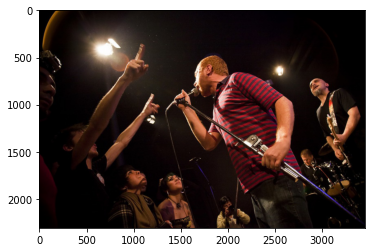

In [ ]:
image = Image.open(example.iloc[0]["path"])
plt.imshow(image)

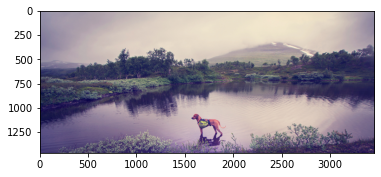

In [ ]:
image = Image.open(example.iloc[1]["path"])
plt.imshow(image)

In [ ]:
data_frame["height"].min()

59

In [ ]:
example = data_frame[data_frame["height"] < 256]

In [ ]:
example["path"].size

8

In [ ]:
example = data_frame[data_frame["width"] < 256]
example["path"].size

210

In [ ]:
example = data_frame[data_frame["height"] == 256]
example["path"].size

2

In [ ]:
example

,path,height,width
1028,data/imagenetv2-matched-frequency-format-val/6...,256,171
4648,data/imagenetv2-matched-frequency-format-val/6...,256,450


In [ ]:
example = data_frame[data_frame["width"] == 512]

In [ ]:
example["path"].size

8

In [ ]:
example.head(8)

,path,height,width
773,data/imagenetv2-matched-frequency-format-val/5...,300,512
2636,data/imagenetv2-matched-frequency-format-val/6...,384,512
4951,data/imagenetv2-matched-frequency-format-val/5...,368,512
6519,data/imagenetv2-matched-frequency-format-val/1...,384,512
7099,data/imagenetv2-matched-frequency-format-val/1...,341,512
8445,data/imagenetv2-matched-frequency-format-val/1...,339,512
8689,data/imagenetv2-matched-frequency-format-val/1...,512,512
8704,data/imagenetv2-matched-frequency-format-val/6...,383,512


In [ ]:
example_image_path = example.iloc[6]["path"]

In [ ]:
image = Image.open(example_image_path)

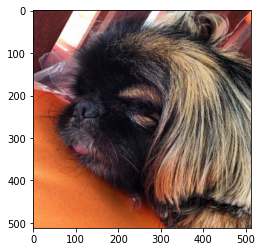

In [ ]:
plt.imshow(image)

In [ ]:
image = np.asarray(image)

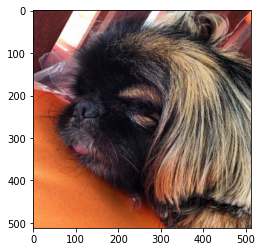

In [ ]:
plt.imshow(image)

In [ ]:
image_2 = image[256:, :, :]
image_2.shape

(256, 512, 3)

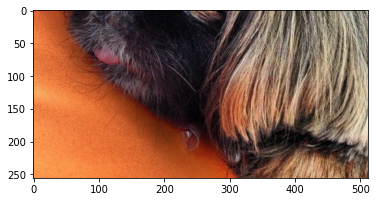

In [ ]:
plt.imshow(image_2)

In [ ]:
im = Image.fromarray(image_2)

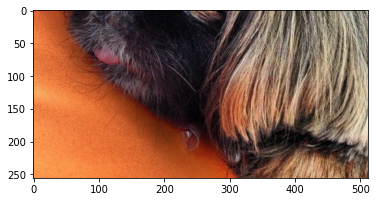

In [ ]:
plt.imshow(im)

In [ ]:
image.save("try2.jpg")

## Clean data

In [ ]:
clean_dataframe = data_frame[data_frame["width"] >= 256]
clean_dataframe["path"].size

9790

In [ ]:
clean_dataframe = clean_dataframe[data_frame["height"] >= 256]
clean_dataframe["path"].size

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


9573

In [ ]:
clean_dataframe["path"].size

9573

In [ ]:
example = clean_dataframe[clean_dataframe["height"] == clean_dataframe["height"].min()]

In [ ]:
example.head()

,path,height,width
7951,data/imagenetv2-matched-frequency-format-val/6...,256,450


In [ ]:
clean_dataframe.head()

,path,height,width
1,data/imagenetv2-matched-frequency-format-val/2...,320,480
2,data/imagenetv2-matched-frequency-format-val/2...,375,500
3,data/imagenetv2-matched-frequency-format-val/2...,354,500
4,data/imagenetv2-matched-frequency-format-val/2...,333,500
5,data/imagenetv2-matched-frequency-format-val/2...,440,440


In [ ]:
clean_dataframe.to_parquet('data/clean_image_paths.parquet')

In [ ]:
# add tps module
# rotate images
# change image size
# change rgb to lab

# Data Utils

In [ ]:
!pip install tfa-nightly

     |████████████████████████████████| 1.1 MB 4.3 MB/s 


### TPS Module

In [ ]:
# <DataUtils>

In [ ]:
from __future__ import division

In [ ]:
#! import tensorflow as tf

In [ ]:
import tensorflow_addons as tfa

In [ ]:
def get_L_inverse(X, Y):
  N = X.shape[0]
  Xmat = tf.repeat(X, repeats=[13], axis=1) # Expand to right 9x9
  Ymat = tf.repeat(Y, repeats=[13], axis=1) # Expand to right 9x9

  P_dist_squared = tf.square(Xmat - tf.transpose(Xmat)) + tf.square(Ymat - tf.transpose(Ymat))
  P_dist_squared = tf.where(tf.equal(P_dist_squared, 0), tf.ones_like(P_dist_squared), P_dist_squared)
  K = P_dist_squared * tf.math.log(P_dist_squared)

  O = tf.ones([N, 1], dtype=tf.float32)
  Z = tf.zeros([3, 3], dtype=tf.float32)
  P = tf.concat([O, X, Y], axis=1)
  L = tf.concat([tf.concat([K, P], axis=1), tf.concat([tf.transpose(P), Z], axis=1)], axis=0)

  Li = tf.linalg.inv(L)

  return Li

In [ ]:
def create_tps(height=256, width=512):
  grid_size = 3
  axis_coords_x = tf.linspace(0, height * 2, grid_size)
  # when default params: ([  0., 256., 512.]), shape 3
  axis_coords_x = tf.cast(axis_coords_x, tf.float32)

  axis_coords_y = tf.linspace(0, width * 2, grid_size)
  # when default params: ([   0.,  512., 1024.]), shape 3
  axis_coords_y = tf.cast(axis_coords_y, tf.float32)
  
  N = 13
  P_Y, P_X = tf.meshgrid(axis_coords_x, axis_coords_y) # control points
  # Each shape (grid_size, grid_size)

  # when default P_X is
  # [[  0., 256., 512.],
  # [  0., 256., 512.],
  # [  0., 256., 512.]])

  # when default P_Y is
  # [[   0.,    0.,    0.],
  # [ 512.,  512.,  512.],
  # [1024., 1024., 1024.]]
  
  P_X = tf.reshape(P_X, (-1, 1)) # shape (grid_size * grid_size, 1)
  P_Y = tf.reshape(P_Y, (-1, 1)) # shape (grid_size * grid_size, 1)

  scale = (width * 2) * 0.1
  random_points_x = tf.random.uniform(P_X.shape, minval=-scale, maxval=scale)
  random_points_y = tf.random.uniform(P_Y.shape, minval=-scale, maxval=scale)

  DST_X = P_X + random_points_x
  DST_Y = P_Y + random_points_y

  # corners of the grid 0, width * 2  0, height * 2
  corner_points_x = tf.expand_dims([0, 0, width * 2, width * 2], axis=1)
  corner_points_x = tf.cast(corner_points_x, tf.float32)

  corner_points_y = tf.expand_dims([0, height * 2, 0, height * 2], axis=1)
  corner_points_y = tf.cast(corner_points_y, tf.float32)

  DST_X = tf.concat([DST_X, corner_points_x], axis=0) # shape ((grid_size * grid_size) + 3, 1) or (N, 1)
  DST_Y = tf.concat([DST_Y, corner_points_y], axis=0) # shape ((grid_size * grid_size) + 3, 1) or (N, 1)

  Q_X = DST_X
  Q_Y = DST_Y

  Q_X = tf.cast(Q_X, tf.float32) # shape (13, 1)
  Q_Y = tf.cast(Q_Y, tf.float32) # shape (13, 1)
  # contains the modified grid, grid + random points and corner points

  P_X = tf.concat([P_X, corner_points_x], axis=0) # shape (13, 1)
  P_Y = tf.concat([P_Y, corner_points_y], axis=0) # shape (13, 1)
  # contains the original grid and corner points

  Li = get_L_inverse(Q_X, Q_Y)  # shape (16, 16)

  P_X = tf.expand_dims(P_X, 0) # shape (1, 13, 1)
  P_Y = tf.expand_dims(P_Y, 0) # shape (1, 13, 1)

  Li = tf.expand_dims(Li, 0) # shape (1, 16, 16)

  W_X = tf.linalg.matmul(Li[:, :N, :N], P_X) # Automatic broadcast for Li
  W_Y = tf.linalg.matmul(Li[:, :N, :N], P_Y) # Automatic broadcast for Li
  # 1, 13, 13 * 1, 13, 1
  # Ignoring first dimension 13, 13 * 13, 1 == 13, 1
  # shape (1, 13, 1)

  W_X = tf.expand_dims(W_X, 3)
  W_X = tf.expand_dims(W_X, 4)
  # shape (1, 13, 1, 1, 1)
  W_X = tf.transpose(W_X, [0, 4, 2, 3, 1])
  # shape (1, 1, 1, 1, 13)

  W_Y = tf.expand_dims(W_Y, 3)
  W_Y = tf.expand_dims(W_Y, 4)
  # shape (1, 13, 1, 1, 1)
  W_Y = tf.transpose(W_Y, [0, 4, 2, 3, 1])
  # shape (1, 1, 1, 1, 13)

  # compute weights for affine part
  A_X = tf.linalg.matmul(Li[:, N:, :N], P_X) # Automatic broadcast for Li
  A_Y = tf.linalg.matmul(Li[:, N:, :N], P_Y) # Automatic broadcast for Li
  # 1, 3, 13 * 1, 13, 1
  # Ignoring first dimension 3, 13 * 13, 1 == 3, 1
  # shape (1, 3, 1)

  A_X = tf.expand_dims(A_X, 3)
  A_X = tf.expand_dims(A_X, 4)
  A_X = tf.transpose(A_X, [0, 4, 2, 3, 1])

  A_Y = tf.expand_dims(A_Y, 3)
  A_Y = tf.expand_dims(A_Y, 4)
  A_Y = tf.transpose(A_Y, [0, 4, 2, 3, 1])
  # shape (1, 1, 1, 1, 3)

  grid_Y, grid_X = tf.meshgrid(tf.linspace(0, width * 2, width), tf.linspace(0, height * 2, height)) # 0, 256, 512
  # shape (256, 512)
 
  grid_X = tf.expand_dims(tf.expand_dims(grid_X, 0), 3)
  grid_Y = tf.expand_dims(tf.expand_dims(grid_Y, 0), 3)
  # shape (1, 256, 512, 1)

  points = tf.concat([grid_X, grid_Y], axis=3)
  points = tf.cast(points, tf.float32)
  # shape (1, 256, 512, 2)

  points_X_for_summation = tf.expand_dims(points[:, :, :, 0], axis=-1) # shape (1, 256, 512, 1)
  points_Y_for_summation = tf.expand_dims(points[:, :, :, 1], axis=-1)

  # change to Q
  Q_X = tf.expand_dims(Q_X, 2)
  Q_X = tf.expand_dims(Q_X, 3)
  Q_X = tf.expand_dims(Q_X, 4)
  Q_X = tf.transpose(Q_X) # shape (1, 1, 1, 1, 13)

  Q_Y = tf.expand_dims(Q_Y, 2)
  Q_Y = tf.expand_dims(Q_Y, 3)
  Q_Y = tf.expand_dims(Q_Y, 4)
  Q_Y = tf.transpose(Q_Y) # shape (1, 1, 1, 1, 13)

  delta_X = Q_X - tf.expand_dims(points_X_for_summation, axis=-1)
  delta_Y = Q_Y - tf.expand_dims(points_Y_for_summation, axis=-1)
  # shape 1, 256, 512, 1, 13

  dist_squared = tf.square(delta_X) + tf.square(delta_Y)
  dist_squared = tf.where(tf.equal(dist_squared, 0), tf.ones_like(dist_squared), dist_squared) # remove 0 values
  U = dist_squared * tf.math.log(dist_squared)
  # shape 1, 256, 512, 1, 13

  points_X_prime = A_X[:, :, :, :, 0] + (A_X[:, :, :, :, 1] * points_X_for_summation) + (A_X[:, :, :, :, 2] * points_Y_for_summation)
  points_X_prime += tf.keras.backend.sum((W_X * U), axis=-1)

  points_Y_prime = A_Y[:, :, :, :, 0] + (A_Y[:, :, :, :, 1] * points_X_for_summation) + (A_Y[:, :, :, :, 2] * points_Y_for_summation)
  points_Y_prime += tf.keras.backend.sum((W_Y * U), axis=-1)
  # shape (1, 256, 512, 1)

  warped_grid = tf.concat([points_X_prime, points_Y_prime], axis=-1)
  # shape (1, 256, 512, 2)

  return warped_grid

In [ ]:
def tps_augmentation(img, tps, height=256, width=512):
  new_max = width
  new_min = 0
  grid_x = (new_max - new_min) / (tf.keras.backend.max(tps[:, :, :, 1]) - tf.keras.backend.min(tps[:, :, :, 1])) * (tps[:, :, :, 1] - tf.keras.backend.max(tps[:, :, :, 1])) + new_max

  new_max = height
  new_min = 0
  grid_y = (new_max - new_min) / (tf.keras.backend.max(tps[:, :, :, 0]) - tf.keras.backend.min(tps[:, :, :, 0])) * (tps[:, :, :, 0] - tf.keras.backend.max(tps[:, :, :, 0])) + new_max

  grid = tf.stack([grid_x, grid_y], axis=-1)

  final_image = tfa.image.resampler(tf.expand_dims(img, axis=0), grid)
  
  return final_image[0]

### RGB, LAB

In [ ]:
def preprocess(image):
    with tf.name_scope('preprocess'):
        # [0, 1] => [-1, 1]
        return image * 2 - 1

def deprocess(image):
    with tf.name_scope('deprocess'):
        # [-1, 1] => [0, 1]
        return (image + 1) / 2

def preprocess_lab(lab):
    with tf.name_scope('preprocess_lab'):
        L_chan, a_chan, b_chan = tf.unstack(lab, axis=2)
        # L_chan: black and white with input range [0, 100]
        # a_chan/b_chan: color channels with input range ~[-110, 110], not exact
        # [0, 100] => [-1, 1],  ~[-110, 110] => [-1, 1]
        return [L_chan / 50 - 1, a_chan / 110, b_chan / 110]

def deprocess_lab(L_chan, a_chan, b_chan):
    with tf.name_scope('deprocess_lab'):
        #TODO This is axis=3 instead of axis=2 when deprocessing batch of images 
               # ( we process individual images but deprocess batches)
        #return tf.stack([(L_chan + 1) / 2 * 100, a_chan * 110, b_chan * 110], axis=3)
        return tf.stack([(L_chan + 1) / 2 * 100, a_chan * 110, b_chan * 110], axis=2)

def augment(image, brightness):
    # (a, b) color channels, combine with L channel and convert to rgb
    a_chan, b_chan = tf.unstack(image, axis=3)
    L_chan = tf.squeeze(brightness, axis=3)
    lab = deprocess_lab(L_chan, a_chan, b_chan)
    rgb = lab_to_rgb(lab)
    return rgb

def check_image(image):
    assertion = tf.assert_equal(tf.shape(image)[-1], 3, message='image must have 3 color channels')
    with tf.control_dependencies([assertion]):
        image = tf.identity(image)

    if image.get_shape().ndims not in (3, 4):
        raise ValueError('image must be either 3 or 4 dimensions')

    # make the last dimension 3 so that you can unstack the colors
    shape = list(image.get_shape())
    shape[-1] = 3
    image.set_shape(shape)
    return image

def rgb_to_lab(srgb):
    # based on https://github.com/torch/image/blob/9f65c30167b2048ecbe8b7befdc6b2d6d12baee9/generic/image.c
    with tf.name_scope('rgb_to_lab'):
        srgb = check_image(srgb)
        srgb_pixels = tf.reshape(srgb, [-1, 3])
        with tf.name_scope('srgb_to_xyz'):
            linear_mask = tf.cast(srgb_pixels <= 0.04045, dtype=tf.float32)
            exponential_mask = tf.cast(srgb_pixels > 0.04045, dtype=tf.float32)
            rgb_pixels = (srgb_pixels / 12.92 * linear_mask) + (((srgb_pixels + 0.055) / 1.055) ** 2.4) * exponential_mask
            rgb_to_xyz = tf.constant([
                #    X        Y          Z
                [0.412453, 0.212671, 0.019334], # R
                [0.357580, 0.715160, 0.119193], # G
                [0.180423, 0.072169, 0.950227], # B
            ])
            xyz_pixels = tf.matmul(rgb_pixels, rgb_to_xyz)

        # https://en.wikipedia.org/wiki/Lab_color_space#CIELAB-CIEXYZ_conversions
        with tf.name_scope('xyz_to_cielab'):
            # convert to fx = f(X/Xn), fy = f(Y/Yn), fz = f(Z/Zn)

            # normalize for D65 white point
            xyz_normalized_pixels = tf.multiply(xyz_pixels, [1/0.950456, 1.0, 1/1.088754])

            epsilon = 6/29
            linear_mask = tf.cast(xyz_normalized_pixels <= (epsilon**3), dtype=tf.float32)
            exponential_mask = tf.cast(xyz_normalized_pixels > (epsilon**3), dtype=tf.float32)
            fxfyfz_pixels = (xyz_normalized_pixels / (3 * epsilon**2) + 4/29) * linear_mask + (xyz_normalized_pixels ** (1/3)) * exponential_mask

            # convert to lab
            fxfyfz_to_lab = tf.constant([
                #  l       a       b
                [  0.0,  500.0,    0.0], # fx
                [116.0, -500.0,  200.0], # fy
                [  0.0,    0.0, -200.0], # fz
            ])
            lab_pixels = tf.matmul(fxfyfz_pixels, fxfyfz_to_lab) + tf.constant([-16.0, 0.0, 0.0])

        return tf.reshape(lab_pixels, tf.shape(srgb))


def lab_to_rgb(lab):
    with tf.name_scope('lab_to_rgb'):
        lab = check_image(lab)
        lab_pixels = tf.reshape(lab, [-1, 3])
        # https://en.wikipedia.org/wiki/Lab_color_space#CIELAB-CIEXYZ_conversions
        with tf.name_scope('cielab_to_xyz'):
            # convert to fxfyfz
            lab_to_fxfyfz = tf.constant([
                #   fx      fy        fz
                [1/116.0, 1/116.0,  1/116.0], # l
                [1/500.0,     0.0,      0.0], # a
                [    0.0,     0.0, -1/200.0], # b
            ])
            fxfyfz_pixels = tf.matmul(lab_pixels + tf.constant([16.0, 0.0, 0.0]), lab_to_fxfyfz)

            # convert to xyz
            epsilon = 6/29
            linear_mask = tf.cast(fxfyfz_pixels <= epsilon, dtype=tf.float32)
            exponential_mask = tf.cast(fxfyfz_pixels > epsilon, dtype=tf.float32)
            xyz_pixels = (3 * epsilon**2 * (fxfyfz_pixels - 4/29)) * linear_mask + (fxfyfz_pixels ** 3) * exponential_mask

            # denormalize for D65 white point
            xyz_pixels = tf.multiply(xyz_pixels, [0.950456, 1.0, 1.088754])

        with tf.name_scope('xyz_to_srgb'):
            xyz_to_rgb = tf.constant([
                #     r           g          b
                [ 3.2404542, -0.9692660,  0.0556434], # x
                [-1.5371385,  1.8760108, -0.2040259], # y
                [-0.4985314,  0.0415560,  1.0572252], # z
            ])
            rgb_pixels = tf.matmul(xyz_pixels, xyz_to_rgb)
            # avoid a slightly negative number messing up the conversion
            rgb_pixels = tf.clip_by_value(rgb_pixels, 0.0, 1.0)
            linear_mask = tf.cast(rgb_pixels <= 0.0031308, dtype=tf.float32)
            exponential_mask = tf.cast(rgb_pixels > 0.0031308, dtype=tf.float32)
            srgb_pixels = (rgb_pixels * 12.92 * linear_mask) + ((rgb_pixels ** (1/2.4) * 1.055) - 0.055) * exponential_mask

        return tf.reshape(srgb_pixels, tf.shape(lab))

In [ ]:
# <DataUtilsEnd>

# Data generator

In [ ]:
# <DataGenerator>

In [ ]:
#! import pandas as pd
#! import os
#! import tensorflow as tf
#! from tensorflow.keras import layers
#! from data_generator.data_utils import rgb_to_lab, create_tps, tps_augmentation

In [ ]:
data_path = os.path.abspath("./data/clean_image_paths.parquet")
df_image_paths = pd.read_parquet(data_path)

In [ ]:
image_height = 256
image_width = 256

In [ ]:
def load_image(image_path):
  img = tf.io.read_file(image_path)
  img = tf.image.decode_jpeg(img, channels=3)
  img = tf.image.convert_image_dtype(img, tf.float32)

  size = tf.shape(img)
  width, height = size[0], size[1]
  max_size = tf.minimum(width, height)
  img = tf.image.random_crop(img, size=(max_size, max_size, 3))

  img = tf.image.resize(img, (image_height, image_width))

  return img

In [ ]:
rotation_layers = tf.keras.Sequential([
  layers.experimental.preprocessing.RandomRotation(0.05, fill_mode="reflect"),
])

In [ ]:
def load_train_image(image_path):
  img = load_image(image_path)

  tps = create_tps(image_height, image_width)
  reference = tps_augmentation(img, tps, height=image_height, width=image_width)

  if tf.random.uniform([]) > 0.5:
    img = tf.image.flip_left_right(img)
  
  if tf.random.uniform([]) > 0.5:
    img = rotation_layers(tf.expand_dims(img, axis=0))[0]

  if tf.random.uniform([]) > 0.5:
    reference = tf.image.flip_left_right(reference)

  if tf.random.uniform([]) > 0.5:
    reference = rotation_layers(tf.expand_dims(reference, axis=0))[0]

  noise = tf.random.normal(shape=tf.shape(reference), mean=0.0, stddev=0.02, dtype=tf.float32)
  reference = tf.add(reference, noise)
  reference = tf.clip_by_value(reference, 0.0, 1.0)

  # lab image
  lab_img = rgb_to_lab(img)

  return lab_img, img, reference

In [ ]:
image_paths = df_image_paths["path"].tolist()

In [ ]:
train_dataset = tf.data.Dataset.from_tensor_slices((image_paths))
train_dataset = train_dataset.shuffle(len(image_paths))
train_dataset = train_dataset.map(load_train_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)

In [ ]:
test_dataset = tf.data.Dataset.from_tensor_slices((image_paths))
test_dataset = test_dataset.map(load_train_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)

In [ ]:
# <DataGeneratorEnd>

In [ ]:
len(image_paths)

9573

# Test Generator

In [ ]:
# <DataGeneratorTest>

In [ ]:
from skimage.color import rgb2lab, lab2rgb

In [ ]:
for lab_img, img, reference_img in train_generator:
  break

In [ ]:
lab_img[:, :, :, 0].numpy().max(), lab_img[:, :, :, 0].numpy().min()

(100.0, 0.0)

In [ ]:
lab_img.shape

TensorShape([128, 256, 256, 3])

In [ ]:
x_rgb = lab_to_rgb(lab_img)
x_rgb.shape

TensorShape([128, 256, 256, 3])

In [ ]:
x_rgb.numpy().max()

0.99999994

In [ ]:
# https://fairyonice.github.io/Color-space-defenitions-in-python-RGB-and-LAB.html

In [ ]:
def extract_single_dim_from_LAB_convert_to_RGB(image, idim):
  '''
  image is a single lab image of shape (None,None,3)
  '''
  z = np.zeros(image.shape)
  if idim != 0 :
      z[:,:,0]=80 ## I need brightness to plot the image along 1st or 2nd axis
  z[:,:,idim] = image[:,:,idim]
  z = lab2rgb(z)
  return(z)

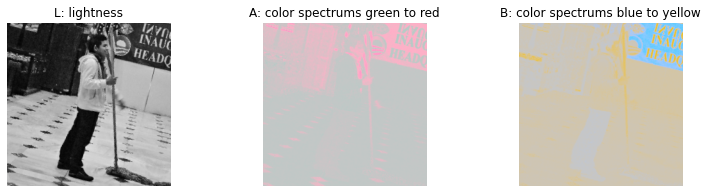

In [ ]:
count = 1
fig = plt.figure(figsize=(13,3))

ax = fig.add_subplot(1,3,count)
lab_rgb_gray = extract_single_dim_from_LAB_convert_to_RGB(lab,0) 
ax.imshow(lab_rgb_gray); ax.axis("off")
ax.set_title("L: lightness")
count += 1

ax = fig.add_subplot(1,3,count)
lab_rgb_gray = extract_single_dim_from_LAB_convert_to_RGB(lab,1) 
ax.imshow(lab_rgb_gray); ax.axis("off")
ax.set_title("A: color spectrums green to red")
count += 1

ax = fig.add_subplot(1,3,count)
lab_rgb_gray = extract_single_dim_from_LAB_convert_to_RGB(lab,2) 
ax.imshow(lab_rgb_gray); ax.axis("off")
ax.set_title("B: color spectrums blue to yellow")
count += 1
plt.show()

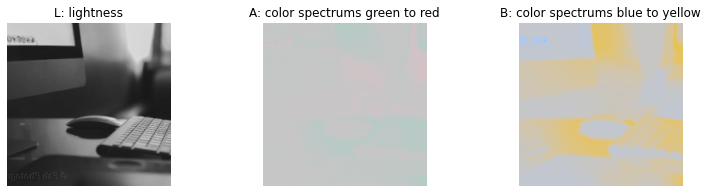

In [ ]:
count = 1
fig = plt.figure(figsize=(13,3))

ax = fig.add_subplot(1,3,count)
lab_rgb_gray = extract_single_dim_from_LAB_convert_to_RGB(lab,0) 
ax.imshow(lab_rgb_gray); ax.axis("off")
ax.set_title("L: lightness")
count += 1

ax = fig.add_subplot(1,3,count)
lab_rgb_gray = extract_single_dim_from_LAB_convert_to_RGB(lab,1) 
ax.imshow(lab_rgb_gray); ax.axis("off")
ax.set_title("A: color spectrums green to red")
count += 1

ax = fig.add_subplot(1,3,count)
lab_rgb_gray = extract_single_dim_from_LAB_convert_to_RGB(lab,2) 
ax.imshow(lab_rgb_gray); ax.axis("off")
ax.set_title("B: color spectrums blue to yellow")
count += 1
plt.show()

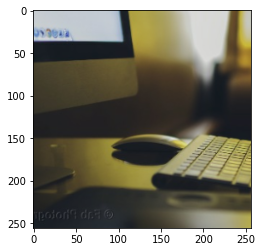

In [ ]:
plt.imshow(lab_to_rgb[0])

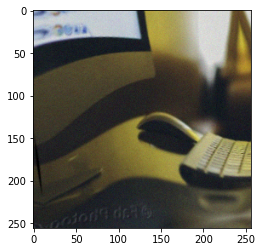

In [ ]:
plt.imshow(reference_img[0])

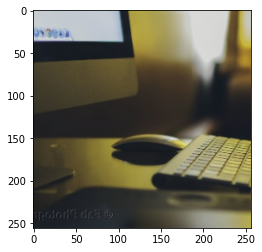

In [ ]:
plt.imshow(img[0])

In [ ]:
# <DataGeneratorTestEnd>

# Blocks

In [ ]:
# <Blocks>

In [ ]:
# https://github.com/manicman1999/StyleGAN2-Tensorflow-2.0/blob/master/conv_mod.py

In [ ]:
#! import tensorflow as tf
#! from tensorflow.keras import layers

In [ ]:
class ColorLayer(layers.Layer):
  def __init__(self, filters, **kwargs):
    super(ColorLayer, self).__init__(**kwargs)
    self.filters = filters
    self.kernel_size = (3, 3)
    self.input_spec = [layers.InputSpec(ndim = 4), layers.InputSpec(ndim = 4)]
  
  def build(self, input_shape):
    channel_axis = -1
    if input_shape[0][channel_axis] is None:
      raise ValueError('The channel dimension of the inputs '
                       'should be defined. Found `None`.')
    
    input_dim = input_shape[0][channel_axis]
    kernel_shape = self.kernel_size + (input_dim, self.filters)

    if input_shape[1][-1] != input_dim:
      raise ValueError('The last dimension of modulation input should be equal to input dimension.')
    
    self.kernel = self.add_weight(shape=kernel_shape,
                                  initializer="he_uniform",
                                  name='kernel')
    
    self.input_spec = [layers.InputSpec(ndim=4, axes={channel_axis: input_dim}), layers.InputSpec(ndim=4)]

    self.built = True
  
  def call(self, inputs):
    # from channels last to channels after batch BxHxWxC to BxCxHxW
    x = tf.transpose(inputs[0], [0, 3, 1, 2])

    # style weigths Bx1x1xinput_dim to Bx1x1xinput_dimx1
    w = tf.expand_dims(inputs[1], axis = -1)

    # add batch to weights
    wo = tf.expand_dims(self.kernel, axis = 0)

    # modulate
    weights = wo * (w+1) # Bx3x3xinput_dimxfilters

    # demodulate

    demodulate = tf.sqrt(tf.reduce_sum(tf.square(weights), axis=[1,2,3], keepdims = True) + 1e-8)
    weights = weights / demodulate # Bx3x3xinput_dimxfilters

    # from BxCxHxW to 1, B*C ,H, W
    x = tf.reshape(x, [1, -1, x.shape[2], x.shape[3]])

    # from B x 3 x 3 x input_dim x filters to 3 x 3 x input_dim x B x filters to 3 x 3 x input_dim x B * filters
    w = tf.reshape(tf.transpose(weights, [1, 2, 3, 0, 4]), [weights.shape[1], weights.shape[2], weights.shape[3], -1])

    x = tf.nn.conv2d(x, w, strides=(1, 1), padding="SAME", data_format="NCHW")

    # from 1, B*C, H, W to B, C, H, W
    x = tf.reshape(x, [-1, self.filters, x.shape[2], x.shape[3]])

    # B, C, H, W to B, H, W, C
    x = tf.transpose(x, [0, 2, 3, 1])

    return x

In [ ]:
class ResBlock(tf.keras.Model):
  def __init__(self, filters):
    super(ResBlock, self).__init__()
    self.conv_1 = layers.Conv2D(filters, (3, 3), strides=(1, 1), padding="SAME")
    self.conv_2 = layers.Conv2D(filters, (3, 3), strides=(1, 1), padding="SAME")
    self.norm_1 = layers.BatchNormalization()
    self.norm_2 = layers.BatchNormalization()
  
  def call(self, input_x):
    x = self.conv_1(input_x)
    x = self.norm_1(x)
    x = layers.ReLU()(x)
    x = self.conv_2(x)
    x = self.norm_2(x)

    x = layers.add([x, input_x])
    x = layers.ReLU()(x)

    return x

In [ ]:
class ResBlockShortCut(tf.keras.Model):
  def __init__(self, filters):
    super(ResBlockShortCut, self).__init__()
    self.conv_1 = layers.Conv2D(filters, (3, 3), strides=(1, 1), padding="SAME")
    self.conv_2 = layers.Conv2D(filters, (3, 3), strides=(1, 1), padding="SAME")
    self.norm_1 = layers.BatchNormalization()
    self.norm_2 = layers.BatchNormalization()

    self.conv = layers.Conv2D(filters, (1, 1), strides=(1, 1))
  
  def call(self, input_x):
    x = self.conv_1(input_x)
    x = self.norm_1(x)
    x = layers.ReLU()(x)
    x = self.conv_2(x)
    x = self.norm_2(x)

    input_x = self.conv(input_x)

    x = layers.add([x, input_x])
    x = layers.ReLU()(x)

    return x

In [ ]:
class DownSamplingBlock(tf.keras.Model):
  def __init__(self, filters):
    super(DownSamplingBlock, self).__init__()
    self.conv = layers.Conv2D(filters, (4, 4), strides=(2, 2), padding="SAME") #downsampling_block
    self.res_block = ResBlock(filters)
  
  def call(self, input_x):
    x = self.conv(input_x)
    x = self.res_block(x)

    return x

In [ ]:
class UpSamplingBlock(tf.keras.Model):
  def __init__(self, filters):
    super(UpSamplingBlock, self).__init__()
    self.up = layers.UpSampling2D(size=(2, 2))
    self.res_block = ResBlockShortCut(filters)
  
  def call(self, input_x, input_down):
    x = self.up(input_x)
    x = tf.keras.layers.Concatenate()([x, input_down])
    x = self.res_block(x)

    return x

In [ ]:
# <BlocksEnd>

# Models

In [ ]:
# <Model>

In [ ]:
#! import tensorflow as tf
#! from tensorflow.keras import layers
#! from networks.model_blocks import DownSamplingBlock, UpSamplingBlock, ColorLayer, ResBlock

In [ ]:
class Generator(tf.keras.Model):
  def __init__(self):
    super(Generator, self).__init__()
    self.conv = layers.Conv2D(64, (3, 3), strides=(1, 1), padding="SAME")

    self.conv_1 = layers.Conv2D(256, (1, 1), strides=(1, 1), kernel_initializer="he_uniform")
    self.conv_2 = layers.Conv2D(128, (1, 1), strides=(1, 1), kernel_initializer="he_uniform")
    self.conv_3 = layers.Conv2D(64, (1, 1), strides=(1, 1), kernel_initializer="he_uniform")
    self.conv_4 = layers.Conv2D(2, (3, 3), strides=(1, 1), padding="SAME")

    self.color_1 = ColorLayer(512)
    self.color_2 = ColorLayer(256)
    self.color_3 = ColorLayer(128)
    self.color_4 = ColorLayer(64)

    self.res_block = ResBlock(64)

    self.down_1 = DownSamplingBlock(128)
    self.down_2 = DownSamplingBlock(256)
    self.down_3 = DownSamplingBlock(512)
    self.down_4 = DownSamplingBlock(512)

    self.up_1 = UpSamplingBlock(512)
    self.up_2 = UpSamplingBlock(256)
    self.up_3 = UpSamplingBlock(128)
    self.up_4 = UpSamplingBlock(64)
  
  def call(self, input_x, style_input):
    x = self.conv(input_x)

    x1 = self.res_block(x) # 256
    x2 = self.down_1(x1) # 128
    x3 = self.down_2(x2) # 64
    x4 = self.down_3(x3) # 32
    x5 = self.down_4(x4) # 16

    x = self.up_1(x5, x4)
    x = self.color_1([x, style_input])

    style = self.conv_1(style_input)

    x = self.up_2(x, x3)
    x = self.color_2([x, style])

    style = self.conv_2(style_input)

    x = self.up_3(x, x2)
    x = self.color_3([x, style])

    style = self.conv_3(style_input)

    x = self.up_4(x, x1)
    x = self.color_4([x, style])

    x = self.conv_4(x)

    return x

In [ ]:
class Vgg19(tf.keras.Model):
  def __init__(self):
    super(Vgg19, self).__init__()
    original_vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    original_vgg.trainable = False
    layer = 'block5_conv2' 
    
    output = original_vgg.get_layer(layer).output
    self.model = tf.keras.Model([original_vgg.input], output)
    self.model.trainable = False
  
  def call(self, x):
    x = tf.keras.applications.vgg19.preprocess_input(x * 255.0)
    return self.model(x)

In [ ]:
class ColorEncoder(tf.keras.Model):
  def __init__(self):
    super(ColorEncoder, self).__init__()
    original_vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    original_vgg.trainable = True
    layer = 'block5_conv2' 
    
    output = original_vgg.get_layer(layer).output

    self.model = tf.keras.Model([original_vgg.input], output)

    self.conv = layers.Conv2D(512, (3, 3), strides=(2, 2))

    self.conv_1 = layers.Conv2D(512, (1, 1), strides=(1, 1))
    self.conv_2 = layers.Conv2D(512, (1, 1), strides=(1, 1))
    self.conv_3 = layers.Conv2D(512, (1, 1), strides=(1, 1))
    self.conv_4 = layers.Conv2D(512, (1, 1), strides=(1, 1))

    self.global_avg = layers.Lambda(lambda t4d: tf.reduce_mean(t4d, axis=(1,2), keepdims=True), name='GlobalAverage2D')
  
  def call(self, x):
    x = tf.keras.applications.vgg19.preprocess_input(x * 255.0)
    x = self.model(x)
    x = self.conv(x)
    x = self.global_avg(x)

    x = self.conv_1(x)
    x = tf.keras.layers.LeakyReLU()(x)
    x = self.conv_2(x)
    x = tf.keras.layers.LeakyReLU()(x)
    x = self.conv_3(x)
    x = tf.keras.layers.LeakyReLU()(x)
    x = self.conv_4(x)
    x = tf.keras.layers.LeakyReLU()(x)

    return x

In [ ]:
class CompleteModel(tf.keras.Model):
  def __init__(self):
    super(CompleteModel, self).__init__()
    self.color_encoder = ColorEncoder()
    self.generator = Generator()
  
  def call(self, input_x, input_z):
    z = self.color_encoder(input_z)
    x = self.generator(input_x, z)

    return x

In [ ]:
# <ModelEnd>

# Loss

In [ ]:
# <Loss>

In [ ]:
#! import tensorflow as tf

In [ ]:
l1_smooth = tf.keras.losses.Huber()

def compute_reconstruction_loss(y_true, y_fake, HUBER_DELTA=1):
  return l1_smooth(y_true, y_fake)

In [ ]:
def perceptual_loss(feature_map_true, feature_map_fake):
  return tf.reduce_mean(tf.math.abs(feature_map_true - feature_map_fake))

In [ ]:
def compute_loss(ab_images, ab_pred_images, feature_map_true, feature_map_fake, lambda_perc=0.1):
  rec_loss = compute_reconstruction_loss(ab_images, ab_pred_images)

  perc_loss = perceptual_loss(feature_map_true, feature_map_fake) * lambda_perc

  loss = rec_loss + perc_loss

  return loss, rec_loss, perc_loss

In [ ]:
# <LossEnd>

# Training Utils

In [ ]:
# <TrainingUtils>

In [ ]:
#! import tensorflow as tf
#! from networks.loss_functions import compute_loss
#! from data_generator.data_utils import lab_to_rgb

In [ ]:
def inner_step(lab_images, 
               images, 
               reference_images, 
               main_model,
               vgg,
               optimizer):
  l_images = lab_images[:, :, :, :1] # Bx256x256x1
  ab_images = lab_images[:, :, :, 1:] # Bx256x256x2

  # a_n = (ab_images[:, :, :, :1] + 86.185) / 184.439
  # b_n = (ab_images[:, :, :, 1:] + 107.863) / 202.345

  l_normalized = l_images / 100.0

  # ab_images = tf.concat([a_n, b_n], axis=-1)

  with tf.GradientTape() as tape:
    # ab_pred_images = main_model([l_images, reference_images])
    # style_z = color_encoder(reference_images)
    # ab_pred_images = model(l_normalized, style_z)

    ab_pred_images = main_model(l_normalized, reference_images)

    a = tf.clip_by_value(ab_pred_images[:, :, :, :1], -86.185, 98.254)
    b = tf.clip_by_value(ab_pred_images[:, :, :, 1:], -107.863, 94.482)

    ab_range = tf.concat([a, b], axis=-1) # original range

    # a_n = (a + 86.185) / 184.439
    # b_n = (b + 107.863) / 202.345

    # ab_pred_normalized = tf.concat([a_n, b_n], axis=-1)

    feature_map_true = vgg(images) # Bx16x16x512
    
    fake_lab_images = tf.concat([l_images, ab_range], axis=-1) # Bx256x256x3
    fake_rgb_images = lab_to_rgb(fake_lab_images) # returns stats between 0-1

    # print(fake_rgb_images.numpy().max())

    feature_map_fake = vgg(fake_rgb_images) # Bx16x16x512

    loss, rec_loss, perc_loss = compute_loss(ab_images, ab_range, feature_map_true, feature_map_fake)
  
  # color_gradients = color_tape.gradient(loss, color_encoder.trainable_variables)
  gradients = tape.gradient(loss, main_model.trainable_variables)

  # color_optimizer.apply_gradients(zip(color_gradients, color_encoder.trainable_variables))
  optimizer.apply_gradients(zip(gradients, main_model.trainable_variables))

  return loss, rec_loss, perc_loss

In [ ]:
# <TrainingUtilsEnd>

# Train

In [ ]:
# <Train>

In [ ]:
#! import tensorflow as tf
#! import time
#! import os
#! from train_utils import inner_step

In [ ]:
#! from networks.models import Vgg19, CompleteModel

In [ ]:
#! from data_generator.data_generator import train_dataset, image_paths 

In [ ]:
import argparse
import builtins

In [ ]:
parser = argparse.ArgumentParser()

In [ ]:
parser.add_argument('--epochs', type=int, default=100, help='Number of epochs to train the model')
parser.add_argument('--batch_size', type=int, default=16, help='Number batches')
parser.add_argument('--continue_training', default=False, action='store_true', help='Use training checkpoints to continue training the model')

_StoreTrueAction(option_strings=['--continue_training'], dest='continue_training', nargs=0, const=True, default=False, type=None, choices=None, help='Use training checkpoints to continue training the model', metavar=None)

In [ ]:
using_notebook = getattr(builtins, "__IPYTHON__", False)

In [ ]:
opts = parser.parse_args([]) if using_notebook else parser.parse_args()

In [ ]:
batch_size = opts.batch_size
epochs = opts.epochs
lr = 1e-4

optimizer = tf.keras.optimizers.Adam(learning_rate=lr)

In [ ]:
vgg = Vgg19() # output shape 1, 16, 16, 512 for image 256x256
vgg.trainable = False

80150528/80134624 [==============================] - 1s 0us/step


In [ ]:
main_model = CompleteModel()

In [ ]:
train_generator = train_dataset.batch(batch_size)

In [ ]:
train_steps = int(len(image_paths) / batch_size) + 1

In [ ]:
if using_notebook:
  print(train_steps)

599


In [ ]:
## !mkdir training_checkpoints

In [ ]:
## !cp drive/MyDrive/ckpt-225.data-00000-of-00001 training_checkpoints/

In [ ]:
## !unzip -q training_checkpoints

In [ ]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(model=main_model, optimizer=optimizer)

In [ ]:
if opts.continue_training:
  print("loading training checkpoints: ")                   
  print(tf.train.latest_checkpoint(checkpoint_dir))
  checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [ ]:
loss_metric = tf.keras.metrics.Mean()
loss_results = []

In [ ]:
@tf.function
def train_step(lab_images, images, reference_images):
  return inner_step(lab_images, 
               images, 
               reference_images, 
               main_model,
               vgg,
               optimizer)

In [ ]:
def train(epochs):
  for epoch in range(epochs):
    batch_time = time.time()
    epoch_time = time.time()
    step = 0
    epoch_count = f"0{epoch + 1}/{epochs}" if epoch < 9 else f"{epoch + 1}/{epochs}"

    loss_metric.reset_states()

    for lab_img, img, reference_img in train_generator:
      loss, rec_loss, perc_loss = train_step(lab_img, img, reference_img)
      
      loss_metric.update_state(loss)
      loss = loss_metric.result().numpy()
      step += 1

      loss_results.append(loss)

      print('\r', 'Epoch', epoch_count, '| Step', f"{step}/{train_steps}",
            '| Loss:', f"{loss:.5f}", "| Step Time:", f"{time.time() - batch_time:.2f}", end='')    
        
      batch_time = time.time()

    checkpoint.save(file_prefix=checkpoint_prefix)

    print('\r', 'Epoch', epoch_count, '| Step', f"{step}/{train_steps}",
          '| Loss:', f"{loss:.5f}", "| Epoch Time:", f"{time.time() - epoch_time:.2f}")

In [ ]:
#! train(epochs)

In [ ]:
# <TrainEnd>

Text(0.5, 1.0, 'Loss')

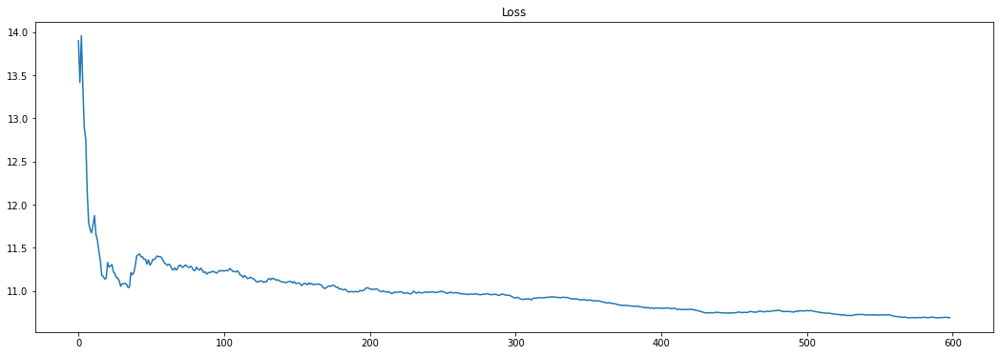

In [ ]:
fig, (ax1) = plt.subplots(1, 1, figsize=(18, 6))

ax1.plot(np.arange(len(loss_results)), loss_results)
ax1.set_title('Loss')

In [ ]:
train(10)

 Epoch 01/10 | Step 599/599 | Loss: 10.45428 | Epoch Time: 1015.26
 Epoch 02/10 | Step 599/599 | Loss: 10.42668 | Epoch Time: 1044.44
 Epoch 03/10 | Step 599/599 | Loss: 10.39568 | Epoch Time: 1044.26
 Epoch 04/10 | Step 599/599 | Loss: 10.37115 | Epoch Time: 1044.52
 Epoch 05/10 | Step 599/599 | Loss: 10.33294 | Epoch Time: 1044.59
 Epoch 06/10 | Step 599/599 | Loss: 10.29913 | Epoch Time: 1044.43
 Epoch 07/10 | Step 599/599 | Loss: 10.25867 | Epoch Time: 1044.46
 Epoch 08/10 | Step 599/599 | Loss: 8.89359 | Epoch Time: 1044.51
 Epoch 09/10 | Step 599/599 | Loss: 8.61357 | Epoch Time: 1044.52
 Epoch 10/10 | Step 599/599 | Loss: 8.48661 | Epoch Time: 1044.47


Text(0.5, 1.0, 'Loss')

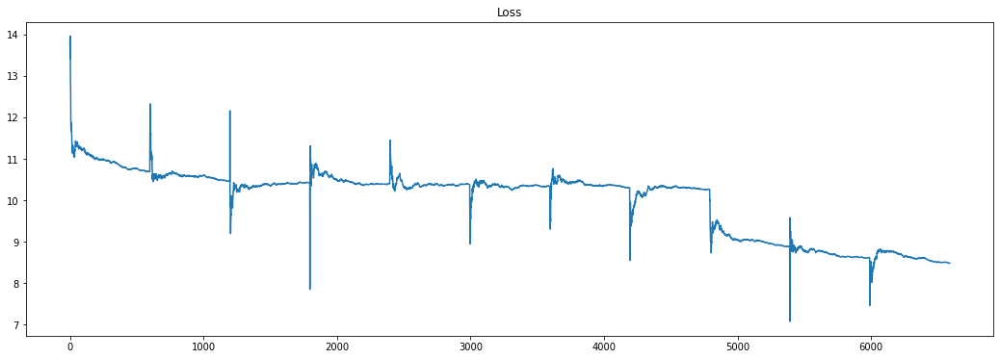

In [ ]:
fig, (ax1) = plt.subplots(1, 1, figsize=(18, 6))

ax1.plot(np.arange(len(loss_results)), loss_results)
ax1.set_title('Loss')

In [ ]:
min(loss_results)

7.0782533

In [ ]:
train(10)

 Epoch 01/10 | Step 599/599 | Loss: 8.36738 | Epoch Time: 1104.86
 Epoch 02/10 | Step 599/599 | Loss: 8.27592 | Epoch Time: 1105.11
 Epoch 03/10 | Step 599/599 | Loss: 7.94162 | Epoch Time: 1044.52
 Epoch 04/10 | Step 599/599 | Loss: 7.64986 | Epoch Time: 1044.56
 Epoch 05/10 | Step 599/599 | Loss: 7.46658 | Epoch Time: 1038.35
 Epoch 06/10 | Step 599/599 | Loss: 7.36674 | Epoch Time: 1044.51
 Epoch 07/10 | Step 599/599 | Loss: 7.30091 | Epoch Time: 1044.59
 Epoch 08/10 | Step 599/599 | Loss: 7.21912 | Epoch Time: 1044.61
 Epoch 09/10 | Step 599/599 | Loss: 7.20912 | Epoch Time: 1038.47
 Epoch 10/10 | Step 599/599 | Loss: 7.11552 | Epoch Time: 1044.49


Text(0.5, 1.0, 'Loss')

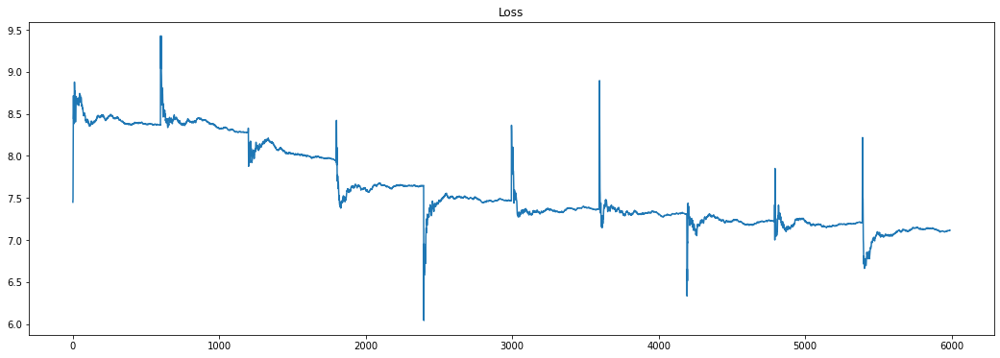

In [ ]:
fig, (ax1) = plt.subplots(1, 1, figsize=(18, 6))

ax1.plot(np.arange(len(loss_results)), loss_results)
ax1.set_title('Loss')

In [ ]:
min(loss_results)

6.0419726

In [ ]:
train(10)

 Epoch 01/10 | Step 599/599 | Loss: 7.11103 | Epoch Time: 1044.61
 Epoch 02/10 | Step 599/599 | Loss: 7.06907 | Epoch Time: 1044.57
 Epoch 03/10 | Step 599/599 | Loss: 7.01664 | Epoch Time: 1044.48
 Epoch 04/10 | Step 599/599 | Loss: 6.92318 | Epoch Time: 1044.54
 Epoch 05/10 | Step 599/599 | Loss: 6.84983 | Epoch Time: 1044.64
 Epoch 06/10 | Step 599/599 | Loss: 6.74051 | Epoch Time: 1044.52
 Epoch 07/10 | Step 599/599 | Loss: 6.66979 | Epoch Time: 1044.48
 Epoch 08/10 | Step 599/599 | Loss: 6.58530 | Epoch Time: 1044.53
 Epoch 09/10 | Step 599/599 | Loss: 6.55151 | Epoch Time: 1044.44
 Epoch 10/10 | Step 599/599 | Loss: 6.48712 | Epoch Time: 1044.85


In [ ]:
min(loss_results)

5.3823113

In [ ]:
train(10)

 Epoch 01/10 | Step 599/599 | Loss: 6.48645 | Epoch Time: 1020.16
 Epoch 02/10 | Step 599/599 | Loss: 6.42682 | Epoch Time: 1044.41
 Epoch 03/10 | Step 599/599 | Loss: 6.43108 | Epoch Time: 1044.52
 Epoch 04/10 | Step 599/599 | Loss: 6.41618 | Epoch Time: 1044.51
 Epoch 05/10 | Step 599/599 | Loss: 6.33896 | Epoch Time: 1044.76
 Epoch 06/10 | Step 599/599 | Loss: 6.33782 | Epoch Time: 1044.97
 Epoch 07/10 | Step 599/599 | Loss: 6.31693 | Epoch Time: 1044.87
 Epoch 08/10 | Step 599/599 | Loss: 6.25889 | Epoch Time: 1028.39
 Epoch 09/10 | Step 599/599 | Loss: 6.20835 | Epoch Time: 1044.43
 Epoch 10/10 | Step 599/599 | Loss: 6.17502 | Epoch Time: 1044.56


In [ ]:
min(loss_results)

5.3823113

Text(0.5, 1.0, 'Loss')

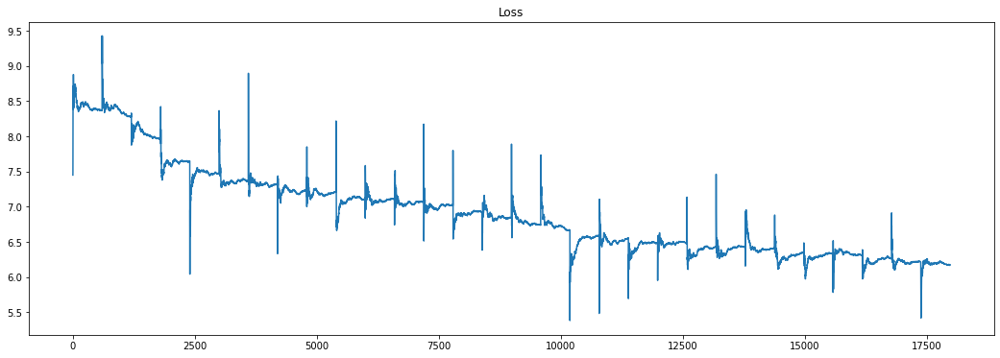

In [ ]:
fig, (ax1) = plt.subplots(1, 1, figsize=(18, 6))

ax1.plot(np.arange(len(loss_results)), loss_results)
ax1.set_title('Loss')

In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 6.12947 | Epoch Time: 1044.49
 Epoch 02/5 | Step 599/599 | Loss: 6.09238 | Epoch Time: 1032.91
 Epoch 03/5 | Step 599/599 | Loss: 6.05512 | Epoch Time: 1044.82
 Epoch 04/5 | Step 599/599 | Loss: 6.05058 | Epoch Time: 1044.44
 Epoch 05/5 | Step 599/599 | Loss: 5.97490 | Epoch Time: 1044.56


In [ ]:
min(loss_results)

4.9673877

In [ ]:
train(2)

 Epoch 01/2 | Step 599/599 | Loss: 5.94601 | Epoch Time: 1044.56
 Epoch 02/2 | Step 599/599 | Loss: 5.92340 | Epoch Time: 1104.58


In [ ]:
min(loss_results)

4.5593624

Text(0.5, 1.0, 'Loss')

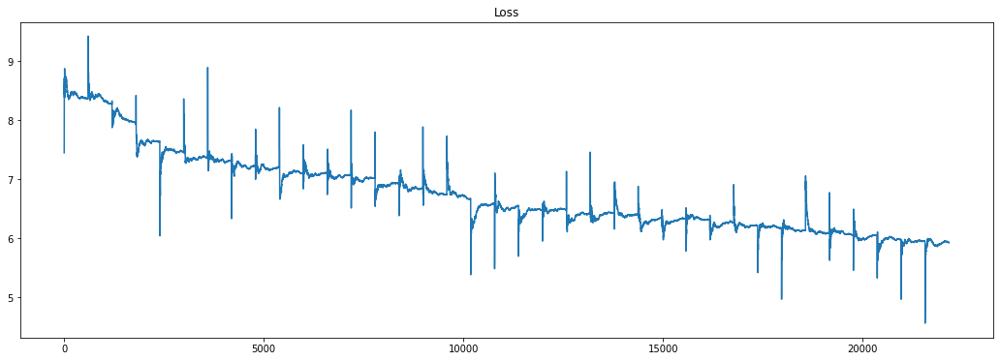

In [ ]:
fig, (ax1) = plt.subplots(1, 1, figsize=(18, 6))

ax1.plot(np.arange(len(loss_results)), loss_results)
ax1.set_title('Loss')

In [ ]:
train(10)

 Epoch 01/10 | Step 599/599 | Loss: 5.89712 | Epoch Time: 1164.94
 Epoch 02/10 | Step 599/599 | Loss: 5.87324 | Epoch Time: 1104.58
 Epoch 03/10 | Step 599/599 | Loss: 5.83767 | Epoch Time: 1104.79
 Epoch 04/10 | Step 599/599 | Loss: 5.81499 | Epoch Time: 1044.63
 Epoch 05/10 | Step 599/599 | Loss: 5.76425 | Epoch Time: 1104.63
 Epoch 06/10 | Step 599/599 | Loss: 5.76048 | Epoch Time: 1104.55
 Epoch 07/10 | Step 599/599 | Loss: 5.72688 | Epoch Time: 1104.57
 Epoch 08/10 | Step 599/599 | Loss: 5.67295 | Epoch Time: 1105.04
 Epoch 09/10 | Step 599/599 | Loss: 5.66327 | Epoch Time: 1036.91
 Epoch 10/10 | Step 599/599 | Loss: 5.62184 | Epoch Time: 1028.53


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 5.59206 | Epoch Time: 1044.74
 Epoch 02/5 | Step 599/599 | Loss: 5.56658 | Epoch Time: 1044.59
 Epoch 03/5 | Step 599/599 | Loss: 5.53237 | Epoch Time: 1037.78
 Epoch 04/5 | Step 599/599 | Loss: 5.51599 | Epoch Time: 1044.63
 Epoch 05/5 | Step 599/599 | Loss: 5.49619 | Epoch Time: 1034.74


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 5.46334 | Epoch Time: 1044.76
 Epoch 02/5 | Step 599/599 | Loss: 5.44181 | Epoch Time: 1044.60
 Epoch 03/5 | Step 599/599 | Loss: 5.40508 | Epoch Time: 1035.13
 Epoch 04/5 | Step 599/599 | Loss: 5.41100 | Epoch Time: 1044.48
 Epoch 05/5 | Step 599/599 | Loss: 5.35201 | Epoch Time: 1044.47


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 5.36884 | Epoch Time: 1044.43
 Epoch 02/5 | Step 599/599 | Loss: 5.30386 | Epoch Time: 1104.57
 Epoch 03/5 | Step 599/599 | Loss: 5.29116 | Epoch Time: 1043.71
 Epoch 04/5 | Step 599/599 | Loss: 5.26776 | Epoch Time: 1036.57
 Epoch 05/5 | Step 599/599 | Loss: 5.22351 | Epoch Time: 1044.52


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 5.22597 | Epoch Time: 1045.14
 Epoch 02/5 | Step 599/599 | Loss: 5.18421 | Epoch Time: 1104.79
 Epoch 03/5 | Step 599/599 | Loss: 5.15076 | Epoch Time: 1044.69
 Epoch 04/5 | Step 599/599 | Loss: 5.14080 | Epoch Time: 1044.51
 Epoch 05/5 | Step 599/599 | Loss: 5.11021 | Epoch Time: 1044.58


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 5.08137 | Epoch Time: 1033.82
 Epoch 02/5 | Step 599/599 | Loss: 5.04352 | Epoch Time: 1044.53
 Epoch 03/5 | Step 599/599 | Loss: 5.02725 | Epoch Time: 1044.53
 Epoch 04/5 | Step 599/599 | Loss: 5.00572 | Epoch Time: 1044.51
 Epoch 05/5 | Step 599/599 | Loss: 4.99398 | Epoch Time: 1044.63


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 4.96780 | Epoch Time: 1029.50
 Epoch 02/5 | Step 599/599 | Loss: 4.93741 | Epoch Time: 1044.54
 Epoch 03/5 | Step 599/599 | Loss: 4.93518 | Epoch Time: 1044.50
 Epoch 04/5 | Step 599/599 | Loss: 4.90187 | Epoch Time: 1044.60
 Epoch 05/5 | Step 599/599 | Loss: 4.88382 | Epoch Time: 1044.54


In [ ]:
train(2)

 Epoch 01/2 | Step 599/599 | Loss: 4.85647 | Epoch Time: 1104.55
 Epoch 02/2 | Step 599/599 | Loss: 4.84636 | Epoch Time: 1104.71


In [ ]:
train(2)

 Epoch 01/2 | Step 599/599 | Loss: 4.82450 | Epoch Time: 1044.63
 Epoch 02/2 | Step 599/599 | Loss: 4.79845 | Epoch Time: 1042.82


In [ ]:
train(1)

 Epoch 01/1 | Step 599/599 | Loss: 4.79469 | Epoch Time: 1104.64


In [ ]:
train(1)

 Epoch 01/1 | Step 599/599 | Loss: 4.76163 | Epoch Time: 1104.55


In [ ]:
train(1)

 Epoch 01/1 | Step 599/599 | Loss: 4.73819 | Epoch Time: 1104.60


In [ ]:
train(1)

 Epoch 01/1 | Step 599/599 | Loss: 4.72969 | Epoch Time: 1044.54


In [ ]:
train(1)

Text(0.5, 1.0, 'Loss')

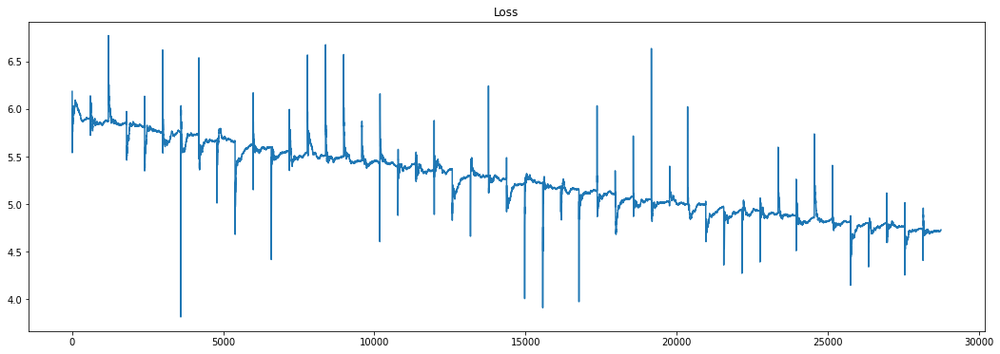

In [ ]:
fig, (ax1) = plt.subplots(1, 1, figsize=(18, 6))

ax1.plot(np.arange(len(loss_results)), loss_results)
ax1.set_title('Loss')

In [ ]:
train(3)

 Epoch 01/3 | Step 599/599 | Loss: 4.69764 | Epoch Time: 1104.91
 Epoch 02/3 | Step 599/599 | Loss: 4.67794 | Epoch Time: 1035.45
 Epoch 03/3 | Step 599/599 | Loss: 4.67634 | Epoch Time: 1044.58


Text(0.5, 1.0, 'Loss')

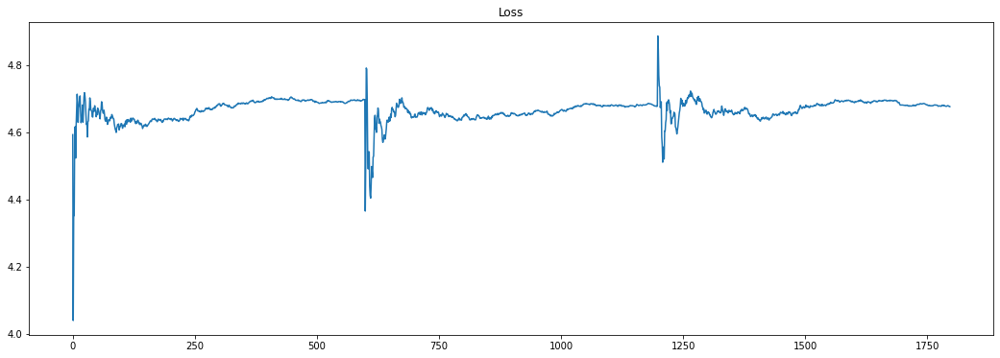

In [ ]:
fig, (ax1) = plt.subplots(1, 1, figsize=(18, 6))

ax1.plot(np.arange(len(loss_results)), loss_results)
ax1.set_title('Loss')

In [ ]:
train(3)

 Epoch 01/3 | Step 599/599 | Loss: 4.64154 | Epoch Time: 1044.50
 Epoch 02/3 | Step 599/599 | Loss: 4.61483 | Epoch Time: 1044.48
 Epoch 03/3 | Step 599/599 | Loss: 4.59664 | Epoch Time: 1032.37


Text(0.5, 1.0, 'Loss')

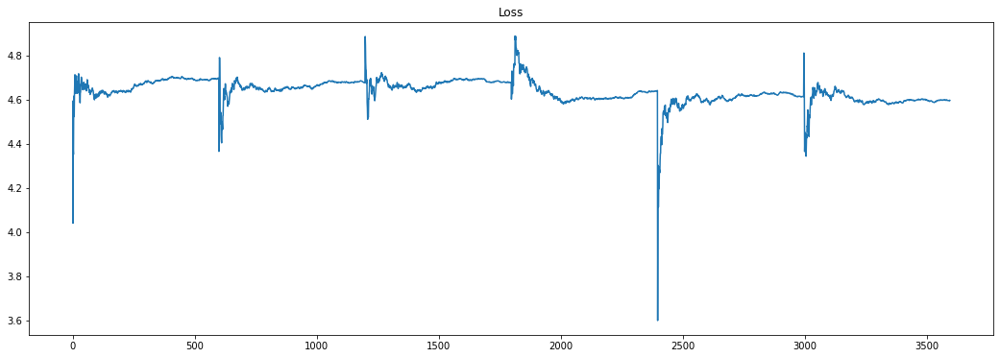

In [ ]:
fig, (ax1) = plt.subplots(1, 1, figsize=(18, 6))

ax1.plot(np.arange(len(loss_results)), loss_results)
ax1.set_title('Loss')

In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 4.58832 | Epoch Time: 1044.57
 Epoch 02/5 | Step 599/599 | Loss: 4.55881 | Epoch Time: 1044.45
 Epoch 03/5 | Step 599/599 | Loss: 4.54524 | Epoch Time: 1044.81
 Epoch 04/5 | Step 599/599 | Loss: 4.53565 | Epoch Time: 1032.80
 Epoch 05/5 | Step 599/599 | Loss: 4.51886 | Epoch Time: 1044.49


In [ ]:
train(3)

 Epoch 01/3 | Step 599/599 | Loss: 4.50381 | Epoch Time: 1044.50
 Epoch 02/3 | Step 599/599 | Loss: 4.47943 | Epoch Time: 1044.67
 Epoch 03/3 | Step 599/599 | Loss: 4.48366 | Epoch Time: 1044.57


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 4.46656 | Epoch Time: 1044.82
 Epoch 02/5 | Step 599/599 | Loss: 4.43340 | Epoch Time: 1032.58
 Epoch 03/5 | Step 599/599 | Loss: 4.45737 | Epoch Time: 1030.95
 Epoch 04/5 | Step 599/599 | Loss: 4.41730 | Epoch Time: 1044.54
 Epoch 05/5 | Step 599/599 | Loss: 4.40341 | Epoch Time: 1029.07


In [ ]:
train(1)

 Epoch 01/1 | Step 599/599 | Loss: 4.38965 | Epoch Time: 1044.47


Text(0.5, 1.0, 'Loss')

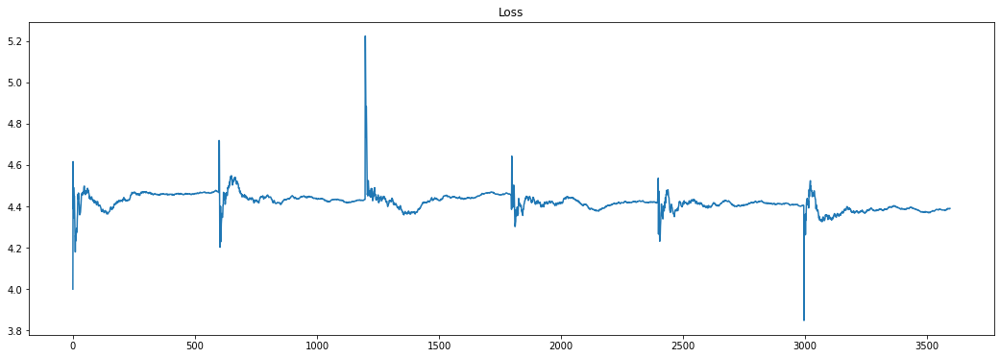

In [ ]:
fig, (ax1) = plt.subplots(1, 1, figsize=(18, 6))

ax1.plot(np.arange(len(loss_results)), loss_results)
ax1.set_title('Loss')

In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 4.37905 | Epoch Time: 1104.63
 Epoch 02/5 | Step 599/599 | Loss: 4.36434 | Epoch Time: 1044.37
 Epoch 03/5 | Step 599/599 | Loss: 4.33345 | Epoch Time: 1012.90
 Epoch 04/5 | Step 599/599 | Loss: 4.33601 | Epoch Time: 1044.53
 Epoch 05/5 | Step 599/599 | Loss: 4.31694 | Epoch Time: 1012.81


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 4.32143 | Epoch Time: 1044.35
 Epoch 02/5 | Step 599/599 | Loss: 4.28842 | Epoch Time: 1044.42
 Epoch 03/5 | Step 599/599 | Loss: 4.27077 | Epoch Time: 1044.39
 Epoch 04/5 | Step 599/599 | Loss: 4.24341 | Epoch Time: 1044.49
 Epoch 05/5 | Step 599/599 | Loss: 4.23288 | Epoch Time: 1011.09


Text(0.5, 1.0, 'Loss')

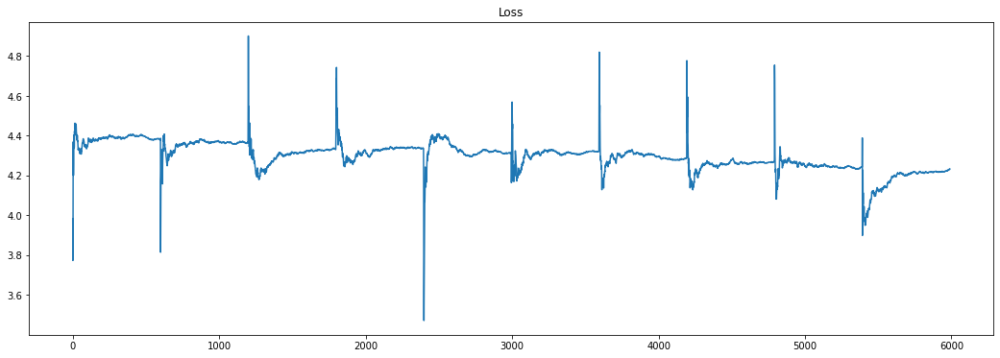

In [ ]:
fig, (ax1) = plt.subplots(1, 1, figsize=(18, 6))

ax1.plot(np.arange(len(loss_results)), loss_results)
ax1.set_title('Loss')

In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 4.23914 | Epoch Time: 1044.41
 Epoch 02/5 | Step 599/599 | Loss: 4.22399 | Epoch Time: 1013.71
 Epoch 03/5 | Step 599/599 | Loss: 4.20674 | Epoch Time: 1012.37
 Epoch 04/5 | Step 599/599 | Loss: 4.20979 | Epoch Time: 1010.60
 Epoch 05/5 | Step 599/599 | Loss: 4.18948 | Epoch Time: 1044.48


Text(0.5, 1.0, 'Loss')

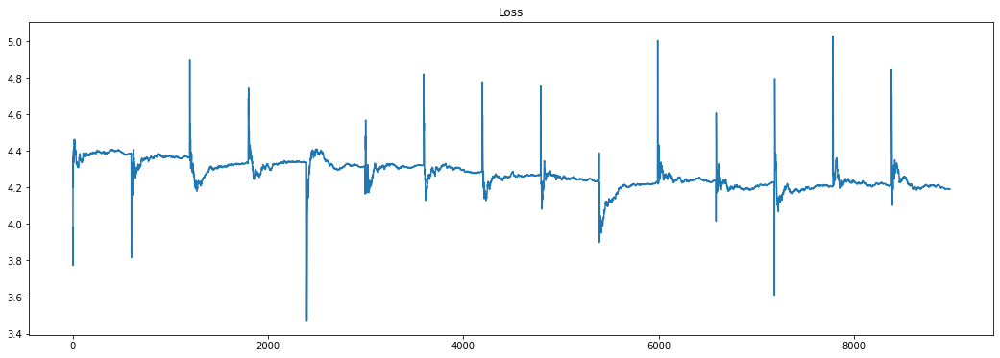

In [ ]:
fig, (ax1) = plt.subplots(1, 1, figsize=(18, 6))

ax1.plot(np.arange(len(loss_results)), loss_results)
ax1.set_title('Loss')

In [ ]:
min(loss_results)

3.4717102

In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 4.18197 | Epoch Time: 864.78
 Epoch 02/5 | Step 599/599 | Loss: 4.16071 | Epoch Time: 804.70
 Epoch 03/5 | Step 599/599 | Loss: 4.15334 | Epoch Time: 804.54
 Epoch 04/5 | Step 599/599 | Loss: 4.14261 | Epoch Time: 804.61
 Epoch 05/5 | Step 599/599 | Loss: 4.12017 | Epoch Time: 804.57


In [ ]:
min(loss_results)

3.5452383

In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 4.11972 | Epoch Time: 804.53
 Epoch 02/5 | Step 599/599 | Loss: 4.11550 | Epoch Time: 804.54
 Epoch 03/5 | Step 599/599 | Loss: 4.08473 | Epoch Time: 777.14
 Epoch 04/5 | Step 599/599 | Loss: 4.08083 | Epoch Time: 804.43
 Epoch 05/5 | Step 599/599 | Loss: 4.08647 | Epoch Time: 744.67


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 4.06531 | Epoch Time: 804.63
 Epoch 02/5 | Step 599/599 | Loss: 4.04339 | Epoch Time: 804.61
 Epoch 03/5 | Step 599/599 | Loss: 4.06838 | Epoch Time: 804.66
 Epoch 04/5 | Step 599/599 | Loss: 4.02812 | Epoch Time: 744.81
 Epoch 05/5 | Step 599/599 | Loss: 4.02822 | Epoch Time: 748.59


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 4.02501 | Epoch Time: 804.49
 Epoch 02/5 | Step 599/599 | Loss: 4.00098 | Epoch Time: 804.63
 Epoch 03/5 | Step 599/599 | Loss: 3.99176 | Epoch Time: 804.59
 Epoch 04/5 | Step 599/599 | Loss: 3.98187 | Epoch Time: 804.47
 Epoch 05/5 | Step 599/599 | Loss: 3.97165 | Epoch Time: 747.68


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.95709 | Epoch Time: 742.54
 Epoch 02/5 | Step 599/599 | Loss: 3.96179 | Epoch Time: 744.49
 Epoch 03/5 | Step 599/599 | Loss: 3.94847 | Epoch Time: 742.84
 Epoch 04/5 | Step 599/599 | Loss: 3.93044 | Epoch Time: 804.49
 Epoch 05/5 | Step 599/599 | Loss: 3.93521 | Epoch Time: 749.87


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.92976 | Epoch Time: 741.34
 Epoch 02/5 | Step 599/599 | Loss: 3.92025 | Epoch Time: 744.50
 Epoch 03/5 | Step 599/599 | Loss: 3.89552 | Epoch Time: 744.50
 Epoch 04/5 | Step 599/599 | Loss: 3.90644 | Epoch Time: 741.68
 Epoch 05/5 | Step 599/599 | Loss: 3.89247 | Epoch Time: 804.57


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.88040 | Epoch Time: 804.55
 Epoch 02/5 | Step 599/599 | Loss: 3.87470 | Epoch Time: 804.62
 Epoch 03/5 | Step 599/599 | Loss: 3.85373 | Epoch Time: 804.47
 Epoch 04/5 | Step 599/599 | Loss: 3.84049 | Epoch Time: 804.62
 Epoch 05/5 | Step 599/599 | Loss: 3.84945 | Epoch Time: 804.66


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.84117 | Epoch Time: 744.87
 Epoch 02/5 | Step 599/599 | Loss: 3.82273 | Epoch Time: 804.49
 Epoch 03/5 | Step 599/599 | Loss: 3.81614 | Epoch Time: 804.64
 Epoch 04/5 | Step 599/599 | Loss: 3.80929 | Epoch Time: 744.49
 Epoch 05/5 | Step 599/599 | Loss: 3.80254 | Epoch Time: 744.61


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.80781 | Epoch Time: 804.54
 Epoch 02/5 | Step 599/599 | Loss: 3.79129 | Epoch Time: 804.46
 Epoch 03/5 | Step 599/599 | Loss: 3.79690 | Epoch Time: 804.51
 Epoch 04/5 | Step 599/599 | Loss: 3.75964 | Epoch Time: 804.69
 Epoch 05/5 | Step 599/599 | Loss: 3.77424 | Epoch Time: 804.52


In [ ]:
train(2)

 Epoch 01/2 | Step 599/599 | Loss: 3.76347 | Epoch Time: 749.07
 Epoch 02/2 | Step 599/599 | Loss: 3.74479 | Epoch Time: 804.60


Text(0.5, 1.0, 'Loss')

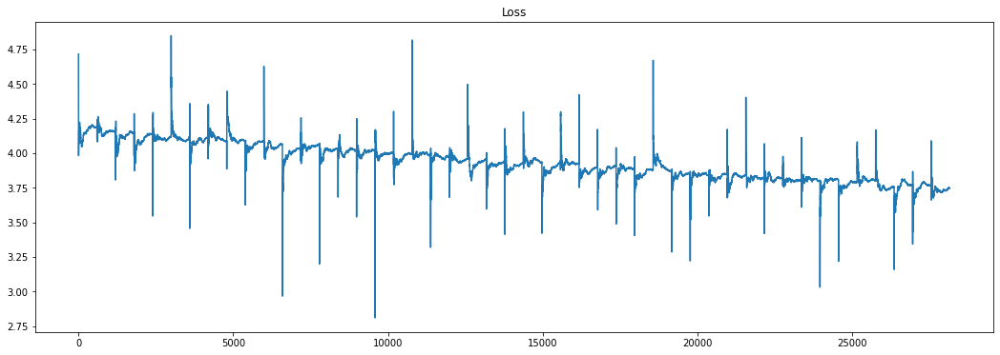

In [ ]:
fig, (ax1) = plt.subplots(1, 1, figsize=(18, 6))

ax1.plot(np.arange(len(loss_results)), loss_results)
ax1.set_title('Loss')

In [ ]:
min(loss_results)

2.8093827

In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.73455 | Epoch Time: 1104.61
 Epoch 02/5 | Step 599/599 | Loss: 3.73948 | Epoch Time: 1104.89
 Epoch 03/5 | Step 599/599 | Loss: 3.73179 | Epoch Time: 1104.81
 Epoch 04/5 | Step 599/599 | Loss: 3.71257 | Epoch Time: 1104.62
 Epoch 05/5 | Step 599/599 | Loss: 3.71680 | Epoch Time: 1104.65


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.70178 | Epoch Time: 1104.64
 Epoch 02/5 | Step 599/599 | Loss: 3.70914 | Epoch Time: 1104.67
 Epoch 03/5 | Step 599/599 | Loss: 3.68692 | Epoch Time: 1104.62
 Epoch 04/5 | Step 599/599 | Loss: 3.67915 | Epoch Time: 1104.66
 Epoch 05/5 | Step 599/599 | Loss: 3.68431 | Epoch Time: 1104.88


Text(0.5, 1.0, 'Loss')

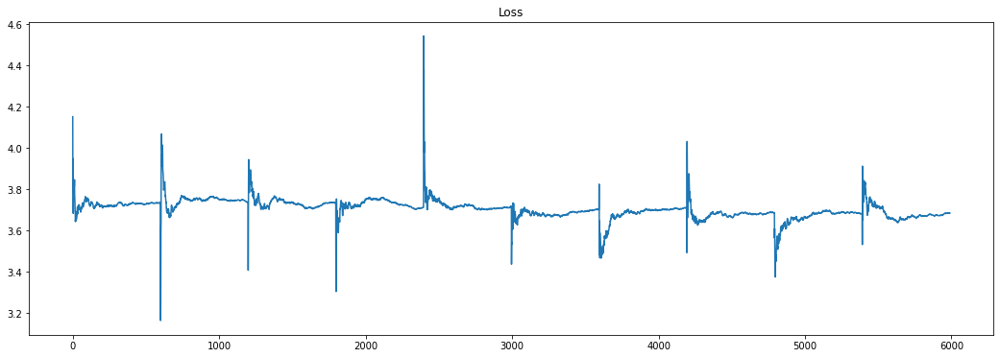

In [ ]:
fig, (ax1) = plt.subplots(1, 1, figsize=(18, 6))

ax1.plot(np.arange(len(loss_results)), loss_results)
ax1.set_title('Loss')

In [ ]:
min(loss_results)

3.1640153

In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.67596 | Epoch Time: 1104.68
 Epoch 02/5 | Step 599/599 | Loss: 3.67357 | Epoch Time: 1104.75
 Epoch 03/5 | Step 599/599 | Loss: 3.66729 | Epoch Time: 1104.68
 Epoch 04/5 | Step 599/599 | Loss: 3.66269 | Epoch Time: 1104.86
 Epoch 05/5 | Step 599/599 | Loss: 3.65587 | Epoch Time: 1104.67


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.64107 | Epoch Time: 1104.93
 Epoch 02/5 | Step 599/599 | Loss: 3.62102 | Epoch Time: 1104.61
 Epoch 03/5 | Step 599/599 | Loss: 3.63014 | Epoch Time: 1104.44
 Epoch 04/5 | Step 599/599 | Loss: 3.62324 | Epoch Time: 1104.61
 Epoch 05/5 | Step 599/599 | Loss: 3.61751 | Epoch Time: 1104.93


Text(0.5, 1.0, 'Loss after +20 epochs')

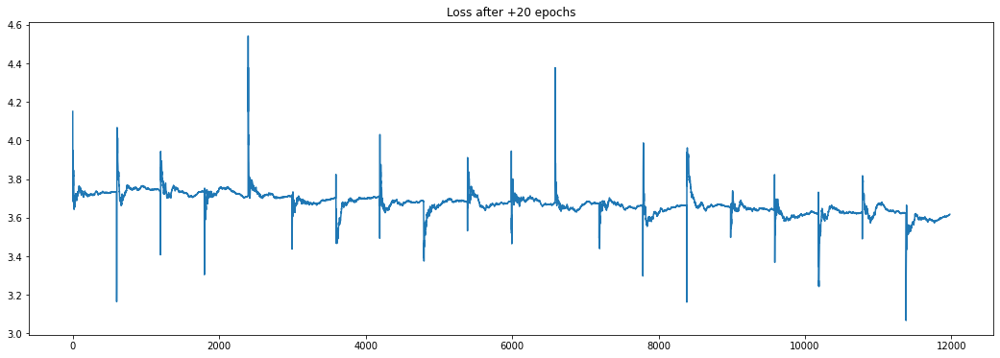

In [ ]:
fig, (ax1) = plt.subplots(1, 1, figsize=(18, 6))

ax1.plot(np.arange(len(loss_results)), loss_results)
ax1.set_title('Loss after +20 epochs')

In [ ]:
print(f"Iterations: {len(loss_results)}")

Iterations: 11980


In [ ]:
max(loss_results), min(loss_results), (sum(loss_results) / len(loss_results))

(4.542108, 3.066544, 3.6740330264643952)

In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.59739 | Epoch Time: 1093.42
 Epoch 02/5 | Step 599/599 | Loss: 3.59839 | Epoch Time: 1022.70
 Epoch 03/5 | Step 599/599 | Loss: 3.60352 | Epoch Time: 1044.27
 Epoch 04/5 | Step 599/599 | Loss: 3.59648 | Epoch Time: 1044.58
 Epoch 05/5 | Step 599/599 | Loss: 3.58358 | Epoch Time: 1044.50


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.57421 | Epoch Time: 1044.38
 Epoch 02/5 | Step 599/599 | Loss: 3.58220 | Epoch Time: 1044.97
 Epoch 03/5 | Step 599/599 | Loss: 3.56955 | Epoch Time: 1044.40
 Epoch 04/5 | Step 599/599 | Loss: 3.55876 | Epoch Time: 1044.39
 Epoch 05/5 | Step 599/599 | Loss: 3.54970 | Epoch Time: 1044.39


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.55727 | Epoch Time: 1015.56
 Epoch 02/5 | Step 599/599 | Loss: 3.54219 | Epoch Time: 1044.47
 Epoch 03/5 | Step 599/599 | Loss: 3.54223 | Epoch Time: 1044.51
 Epoch 04/5 | Step 599/599 | Loss: 3.51933 | Epoch Time: 1063.41
 Epoch 05/5 | Step 599/599 | Loss: 3.53220 | Epoch Time: 1104.62


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.52843 | Epoch Time: 1044.58
 Epoch 02/5 | Step 599/599 | Loss: 3.53249 | Epoch Time: 1015.32
 Epoch 03/5 | Step 599/599 | Loss: 3.52580 | Epoch Time: 1044.38
 Epoch 04/5 | Step 599/599 | Loss: 3.50725 | Epoch Time: 1018.41
 Epoch 05/5 | Step 599/599 | Loss: 3.49896 | Epoch Time: 1044.46


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.50962 | Epoch Time: 1045.56
 Epoch 02/5 | Step 599/599 | Loss: 3.49908 | Epoch Time: 1045.22
 Epoch 03/5 | Step 599/599 | Loss: 3.48894 | Epoch Time: 1044.67
 Epoch 04/5 | Step 599/599 | Loss: 3.47715 | Epoch Time: 1044.51
 Epoch 05/5 | Step 599/599 | Loss: 3.48287 | Epoch Time: 1044.42


In [ ]:
train(3)

 Epoch 01/3 | Step 599/599 | Loss: 3.47899 | Epoch Time: 1044.37
 Epoch 02/3 | Step 599/599 | Loss: 3.46886 | Epoch Time: 1015.90
 Epoch 03/3 | Step 599/599 | Loss: 3.47297 | Epoch Time: 1044.41


In [ ]:
print(f"Iterations: {len(loss_results)}")

Iterations: 16772


In [ ]:
max(loss_results), min(loss_results), (sum(loss_results) / len(loss_results))

(4.328969, 2.6842666, 3.5316414346053553)

Text(0.5, 1.0, 'Loss after +23 epochs')

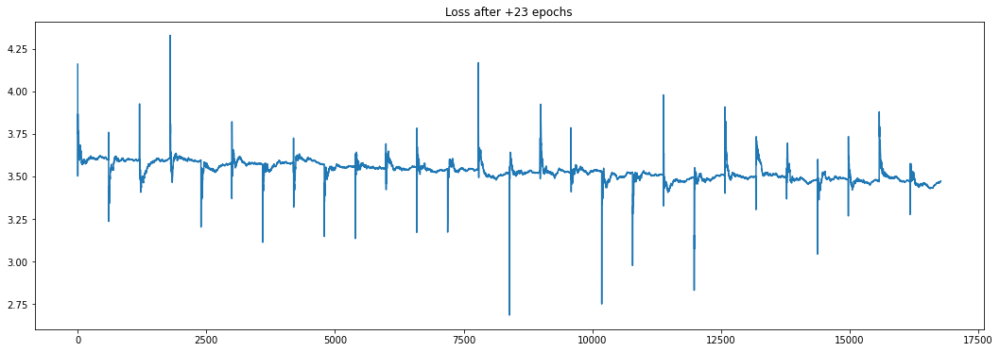

In [ ]:
fig, (ax1) = plt.subplots(1, 1, figsize=(18, 6))

ax1.plot(np.arange(len(loss_results)), loss_results)
ax1.set_title('Loss after +23 epochs')

In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.46588 | Epoch Time: 1104.95
 Epoch 02/5 | Step 599/599 | Loss: 3.46517 | Epoch Time: 1104.47
 Epoch 03/5 | Step 599/599 | Loss: 3.45434 | Epoch Time: 1044.50
 Epoch 04/5 | Step 599/599 | Loss: 3.44087 | Epoch Time: 1044.44
 Epoch 05/5 | Step 599/599 | Loss: 3.44511 | Epoch Time: 1044.47


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.43362 | Epoch Time: 1044.44
 Epoch 02/5 | Step 599/599 | Loss: 3.43006 | Epoch Time: 1044.47
 Epoch 03/5 | Step 599/599 | Loss: 3.42078 | Epoch Time: 1025.43
 Epoch 04/5 | Step 599/599 | Loss: 3.42769 | Epoch Time: 1044.53
 Epoch 05/5 | Step 599/599 | Loss: 3.41696 | Epoch Time: 1044.56


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.40597 | Epoch Time: 1044.49
 Epoch 02/5 | Step 599/599 | Loss: 3.40701 | Epoch Time: 1044.65
 Epoch 03/5 | Step 599/599 | Loss: 3.40268 | Epoch Time: 1044.56
 Epoch 04/5 | Step 599/599 | Loss: 3.40577 | Epoch Time: 1044.47
 Epoch 05/5 | Step 599/599 | Loss: 3.38666 | Epoch Time: 1017.83


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.39350 | Epoch Time: 1044.41
 Epoch 02/5 | Step 599/599 | Loss: 3.37779 | Epoch Time: 1044.49
 Epoch 03/5 | Step 599/599 | Loss: 3.37876 | Epoch Time: 1021.84
 Epoch 04/5 | Step 599/599 | Loss: 3.39181 | Epoch Time: 1044.42
 Epoch 05/5 | Step 599/599 | Loss: 3.37027 | Epoch Time: 1044.46


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.37177 | Epoch Time: 1044.50
 Epoch 02/5 | Step 599/599 | Loss: 3.36402 | Epoch Time: 1044.42
 Epoch 03/5 | Step 599/599 | Loss: 3.36429 | Epoch Time: 1044.43
 Epoch 04/5 | Step 599/599 | Loss: 3.35572 | Epoch Time: 1041.31
 Epoch 05/5 | Step 599/599 | Loss: 3.35319 | Epoch Time: 1044.47


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.34869 | Epoch Time: 1044.47
 Epoch 02/5 | Step 599/599 | Loss: 3.34442 | Epoch Time: 1037.70
 Epoch 03/5 | Step 599/599 | Loss: 3.33987 | Epoch Time: 1044.68
 Epoch 04/5 | Step 599/599 | Loss: 3.33964 | Epoch Time: 1044.38
 Epoch 05/5 | Step 599/599 | Loss: 3.33447 | Epoch Time: 1028.78


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.31795 | Epoch Time: 1044.47
 Epoch 02/5 | Step 599/599 | Loss: 3.32461 | Epoch Time: 1044.46
 Epoch 03/5 | Step 599/599 | Loss: 3.31537 | Epoch Time: 1038.67
 Epoch 04/5 | Step 599/599 | Loss: 3.31805 | Epoch Time: 1044.49
 Epoch 05/5 | Step 599/599 | Loss: 3.30679 | Epoch Time: 1044.58


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.32055 | Epoch Time: 1044.53
 Epoch 02/5 | Step 599/599 | Loss: 3.31157 | Epoch Time: 1044.47
 Epoch 03/5 | Step 599/599 | Loss: 3.30249 | Epoch Time: 1044.42
 Epoch 04/5 | Step 599/599 | Loss: 3.30175 | Epoch Time: 1023.18
 Epoch 05/5 | Step 599/599 | Loss: 3.30515 | Epoch Time: 1044.37


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.29720 | Epoch Time: 1044.84
 Epoch 02/5 | Step 599/599 | Loss: 3.29168 | Epoch Time: 1044.60
 Epoch 03/5 | Step 599/599 | Loss: 3.29002 | Epoch Time: 1022.20
 Epoch 04/5 | Step 599/599 | Loss: 3.29000 | Epoch Time: 1022.68
 Epoch 05/5 | Step 599/599 | Loss: 3.28851 | Epoch Time: 1020.41


In [ ]:
train(5)

 Epoch 01/5 | Step 599/599 | Loss: 3.28230 | Epoch Time: 1044.37
 Epoch 02/5 | Step 599/599 | Loss: 3.27484 | Epoch Time: 1016.80
 Epoch 03/5 | Step 599/599 | Loss: 3.26524 | Epoch Time: 1044.35
 Epoch 04/5 | Step 599/599 | Loss: 3.26507 | Epoch Time: 1011.36
 Epoch 05/5 | Step 599/599 | Loss: 3.27398 | Epoch Time: 1044.42


In [ ]:
# !rm -rf training_checkpoints/

In [ ]:
# !mv training_checkpoints/ckpt-269.data-00000-of-00001 ./

In [ ]:
# !cp training_checkpoints/ckpt-274.data-00000-of-00001 drive/MyDrive

## Test

In [ ]:
#! from data_generator.data_generator import train_dataset 

In [ ]:
test_generator = test_dataset.batch(16)

In [ ]:
def plot_images(images, vertical_size, horizontal_size, figsize=(15, 15)):
  vertical_axes = list(range(vertical_size))
  horizontal_axes = list(range(horizontal_size))

  fig, ax = plt.subplots(vertical_size, horizontal_size, figsize=figsize)
  counter = 0

  if vertical_size == 1:
    for x in horizontal_axes:
      ax[x].imshow(images[counter])
      ax[x].set_title('Image {}'.format(counter + 1))
      counter += 1
  else:
    for y in vertical_axes:
      for x in horizontal_axes:
        ax[y, x].imshow(images[counter])
        ax[y, x].set_title('Image {}'.format(counter + 1))
        counter += 1

In [ ]:
for t_lab_img, t_img, t_reference_img in test_generator:
  break

In [ ]:
l_images = t_lab_img[:, :, :, :1] # Bx256x256x1
ab_images = t_lab_img[:, :, :, 1:] # Bx256x256x2

l_normalized = l_images / 100.0

In [ ]:
test_ab_predicted = main_model(l_normalized, t_reference_img)

In [ ]:
a = tf.clip_by_value(test_ab_predicted[:, :, :, :1], -86.185, 98.254)
b = tf.clip_by_value(test_ab_predicted[:, :, :, 1:], -107.863, 94.482)

ab_range = tf.concat([a, b], axis=-1) # original range

In [ ]:
fake_lab_images = tf.concat([l_images, ab_range], axis=-1) # Bx256x256x3
fake_rgb_images = lab_to_rgb(fake_lab_images) # returns stats between 0-1

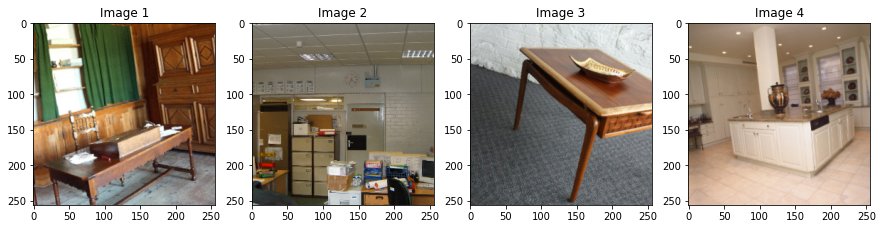

In [ ]:
plot_images(t_img[0:4], 1, 4, figsize=(15, 17))

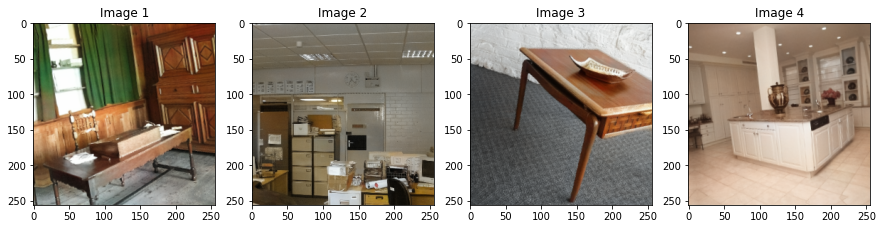

In [ ]:
plot_images(fake_rgb_images[0:4], 1, 4, figsize=(15, 17))

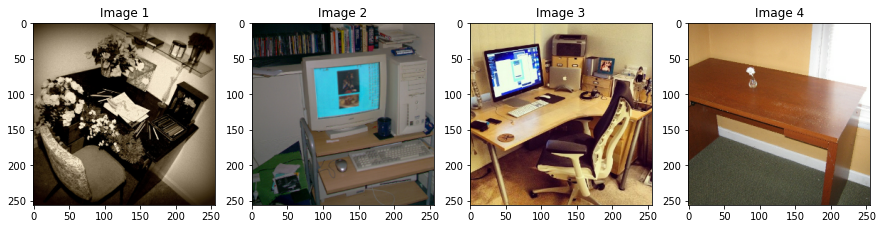

In [ ]:
plot_images(t_img[4:8], 1, 4, figsize=(15, 17))

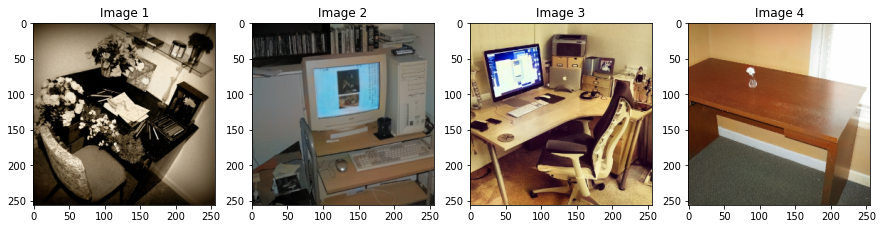

In [ ]:
plot_images(fake_rgb_images[4:8], 1, 4, figsize=(15, 17))

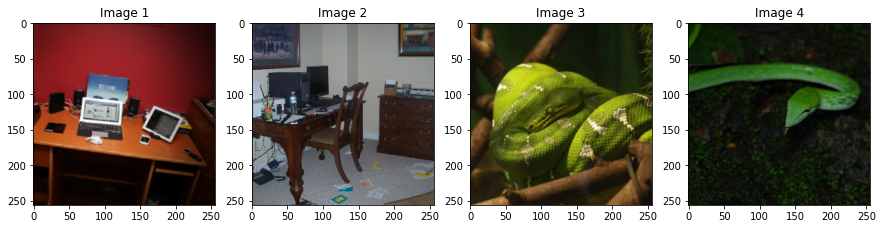

In [ ]:
plot_images(t_img[8:12], 1, 4, figsize=(15, 17))

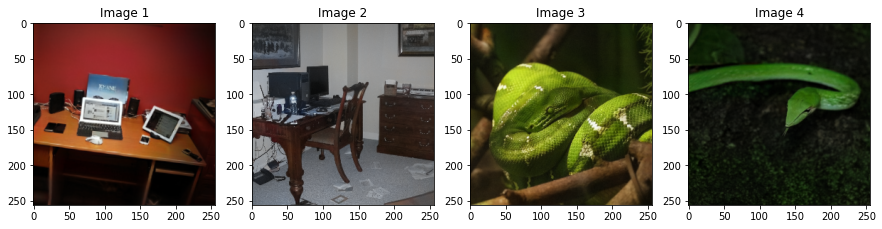

In [ ]:
plot_images(fake_rgb_images[8:12], 1, 4, figsize=(15, 17))

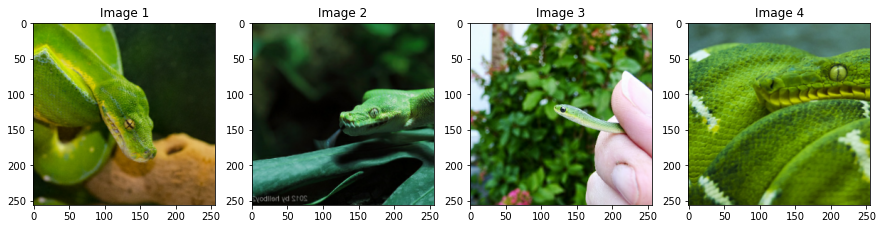

In [ ]:
plot_images(t_img[12:16], 1, 4, figsize=(15, 17))

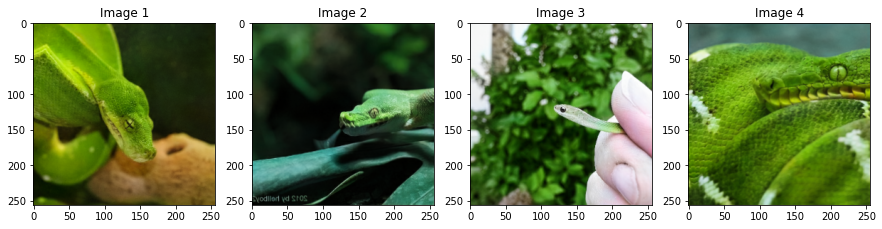

In [ ]:
plot_images(fake_rgb_images[12:16], 1, 4, figsize=(15, 17))

## External Test

In [ ]:
!unzip -q test_images.zip

In [ ]:
def plot_images_one_line(images, figsize=(15, 17)):
  horizontal_axes = list(range(3))
  names = ["original", "reference", "generated"]

  fig, ax = plt.subplots(1, 3, figsize=figsize)
  counter = 0

  for x in horizontal_axes:
    ax[x].imshow(images[counter])
    ax[x].set_title(names[counter])
    counter += 1

In [ ]:
def test_model(image_to_color_path, color_image_path):
  image_to_color = load_image(image_to_color_path)
  color_image = load_image(color_image_path)

  image_to_color = tf.expand_dims(image_to_color, axis=0)
  color_image = tf.expand_dims(color_image, axis=0)

  lab_img = rgb_to_lab(image_to_color)

  l_images = lab_img[:, :, :, :1]
  ab_images = lab_img[:, :, :, 1:]

  l_normalized = l_images / 100.0

  ab_pred = main_model(l_normalized, color_image)

  fake_lab_images = tf.concat([l_images, ab_pred], axis=-1)
  fake_rgb_images = lab_to_rgb(fake_lab_images)

  images = [image_to_color[0], color_image[0], fake_rgb_images[0]]

  plot_images_one_line(images)

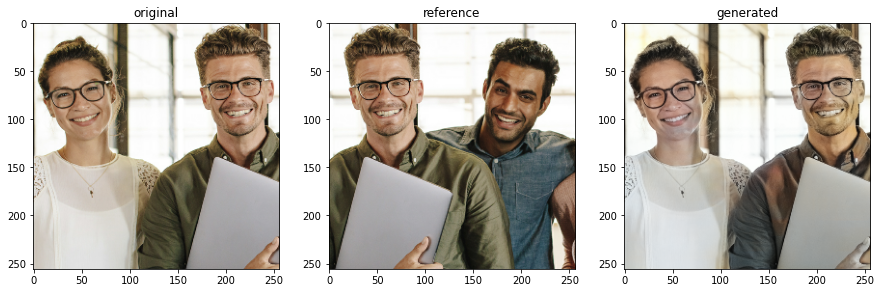

In [ ]:
test_model("test_images/image1.jpeg", "test_images/image2.jpeg")

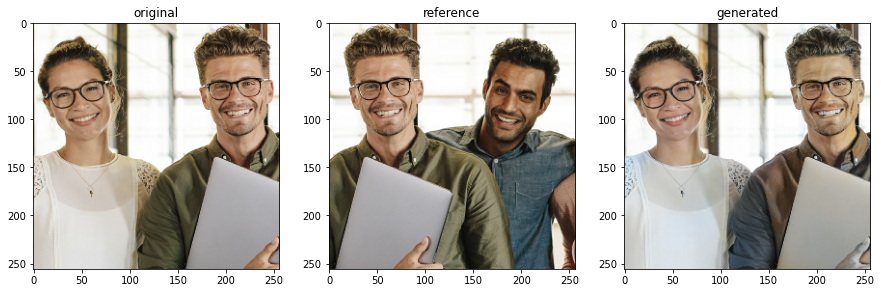

In [ ]:
test_model("test_images/image1.jpeg", "test_images/image2.jpeg") # old

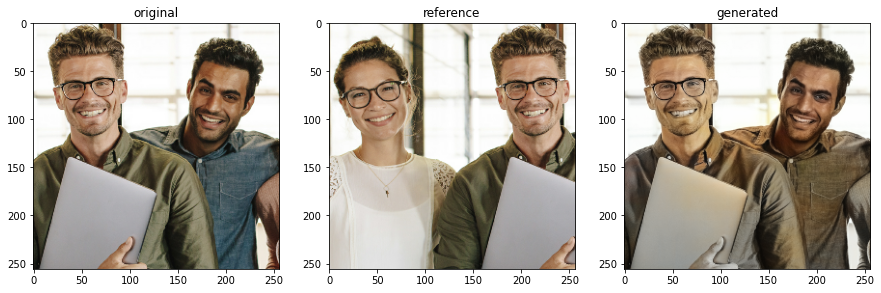

In [ ]:
test_model("test_images/image2.jpeg", "test_images/image1.jpeg")

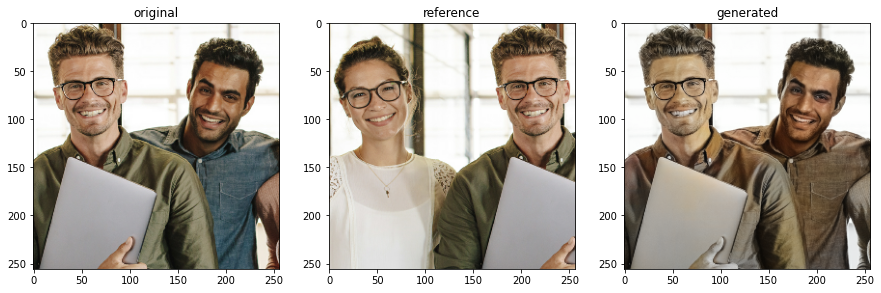

In [ ]:
test_model("test_images/image2.jpeg", "test_images/image1.jpeg") # old

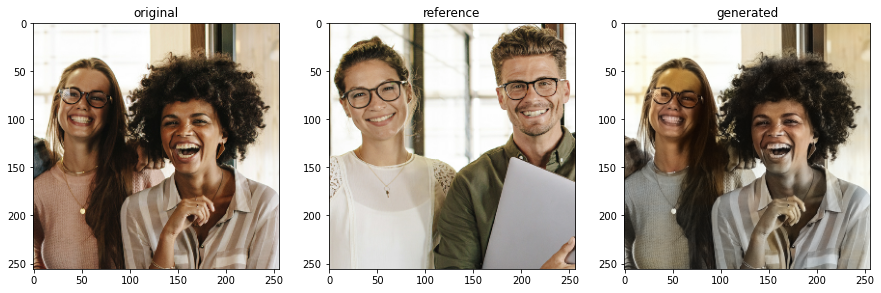

In [ ]:
test_model("test_images/image3.jpeg", "test_images/image1.jpeg")

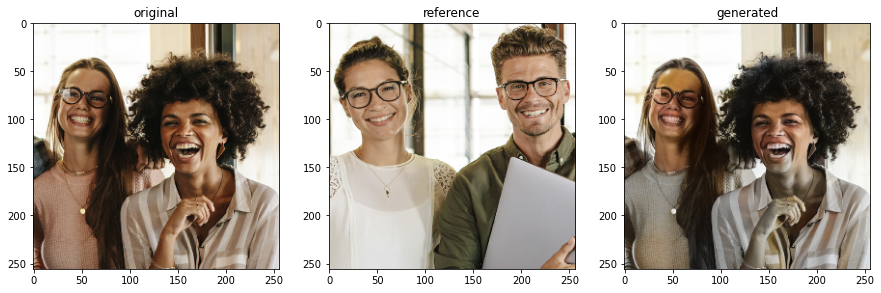

In [ ]:
test_model("test_images/image3.jpeg", "test_images/image1.jpeg") #old

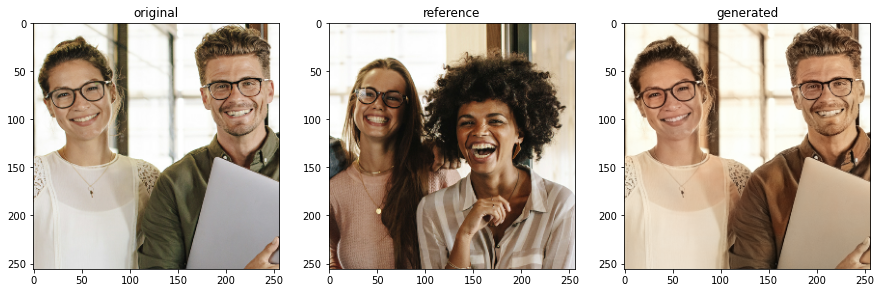

In [ ]:
test_model("test_images/image1.jpeg", "test_images/image3.jpeg")

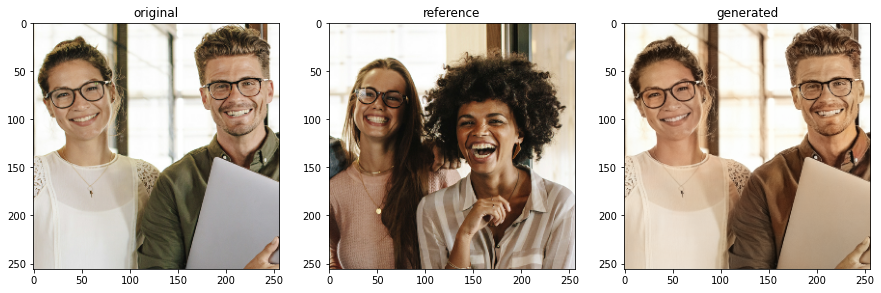

In [ ]:
test_model("test_images/image1.jpeg", "test_images/image3.jpeg") #old

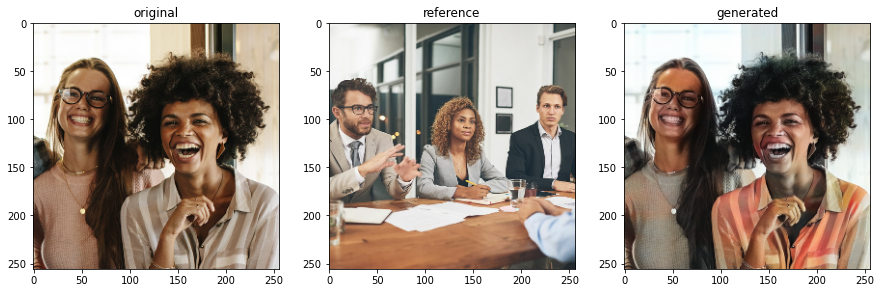

In [ ]:
test_model("test_images/image3.jpeg", "test_images/image4.jpeg")

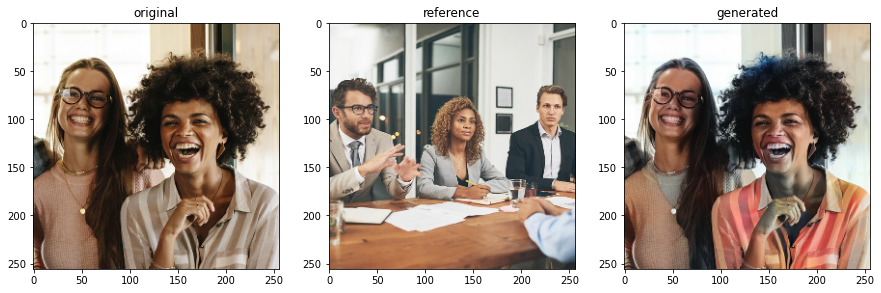

In [ ]:
test_model("test_images/image3.jpeg", "test_images/image4.jpeg") # old

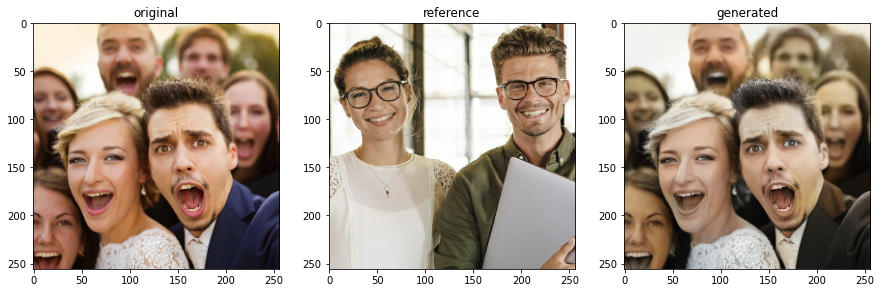

In [ ]:
test_model("test_images/image5.jpeg", "test_images/image1.jpeg")

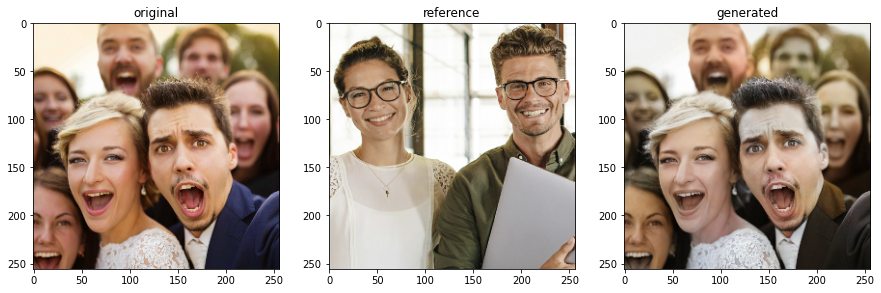

In [ ]:
test_model("test_images/image5.jpeg", "test_images/image1.jpeg") #old

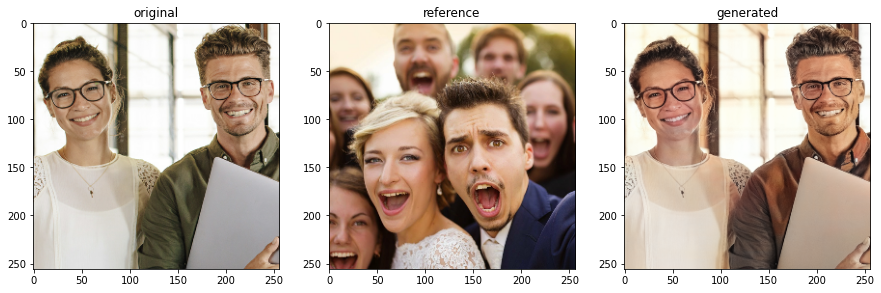

In [ ]:
test_model("test_images/image1.jpeg", "test_images/image5.jpeg")

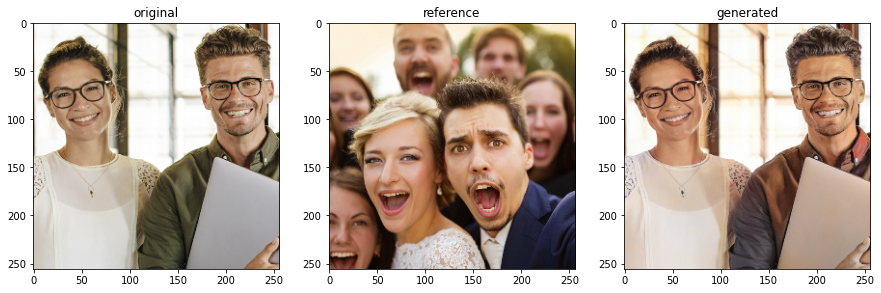

In [ ]:
test_model("test_images/image1.jpeg", "test_images/image5.jpeg")#old

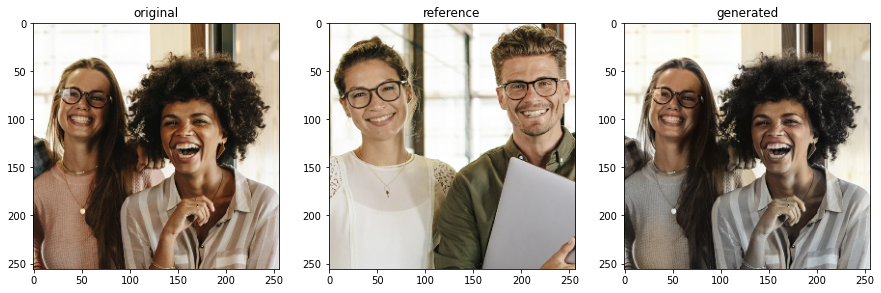

In [ ]:
test_model("test_images/image3.jpeg", "test_images/image1.jpeg")

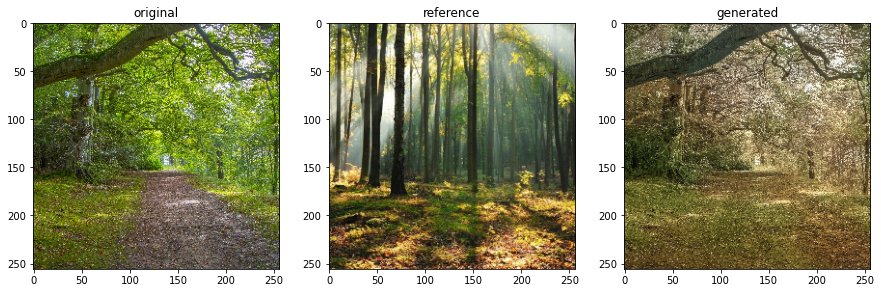

In [ ]:
test_model("test_images/image9.jpeg", "test_images/image7.jpeg")

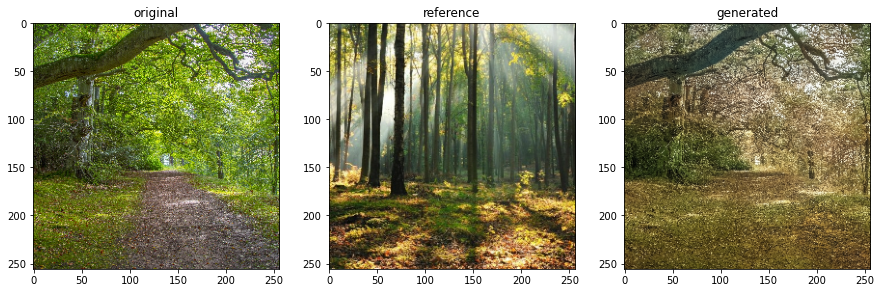

In [ ]:
test_model("test_images/image9.jpeg", "test_images/image7.jpeg") #old

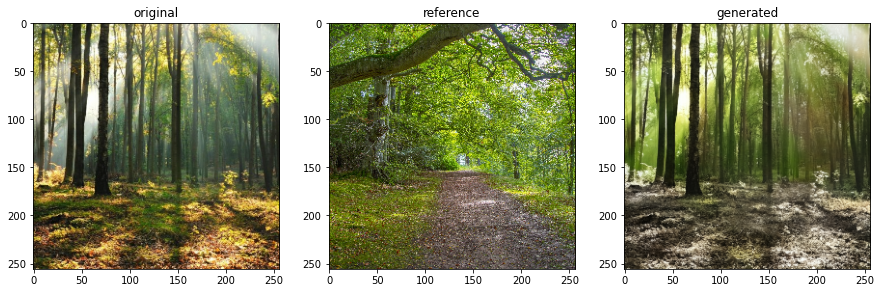

In [ ]:
test_model("test_images/image7.jpeg", "test_images/image9.jpeg")

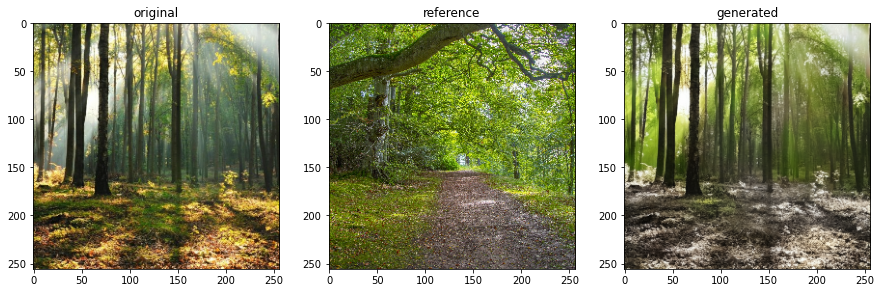

In [ ]:
test_model("test_images/image7.jpeg", "test_images/image9.jpeg") #old

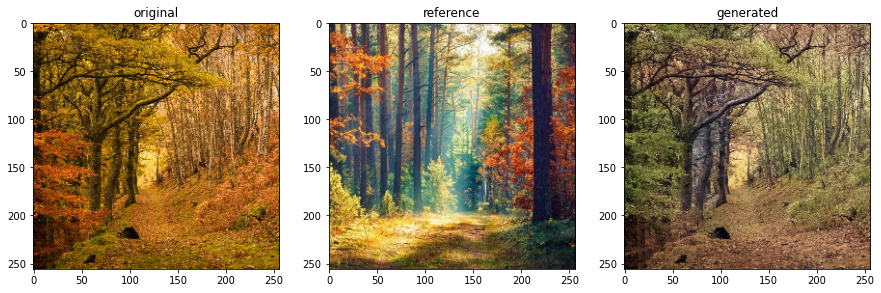

In [ ]:
test_model("test_images/image6.jpeg", "test_images/image8.jpeg")

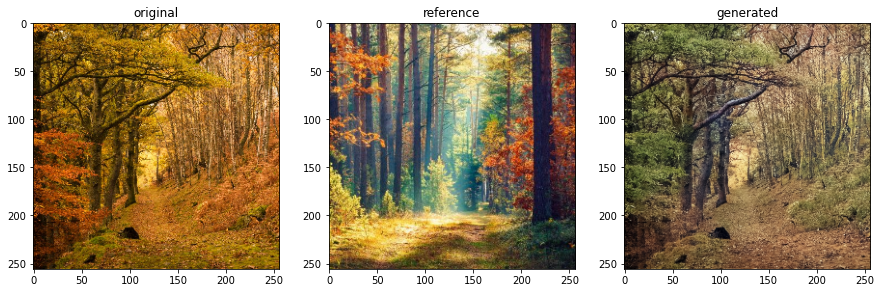

In [ ]:
test_model("test_images/image6.jpeg", "test_images/image8.jpeg") #old

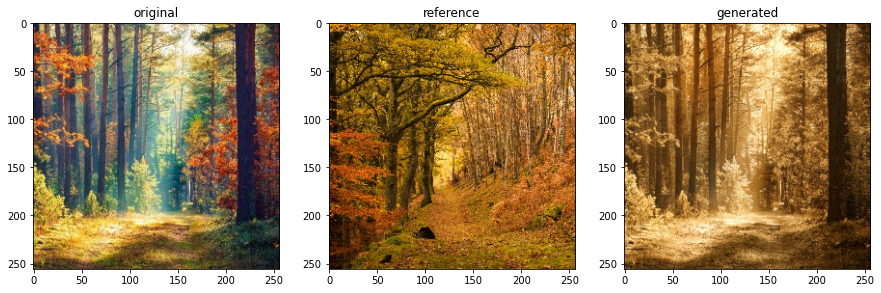

In [ ]:
test_model("test_images/image8.jpeg", "test_images/image6.jpeg")

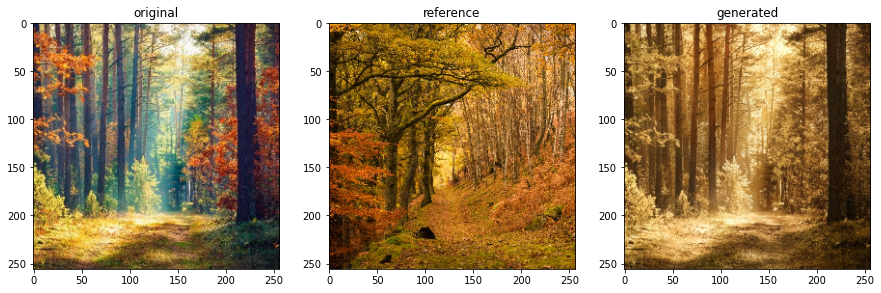

In [ ]:
test_model("test_images/image8.jpeg", "test_images/image6.jpeg") #old

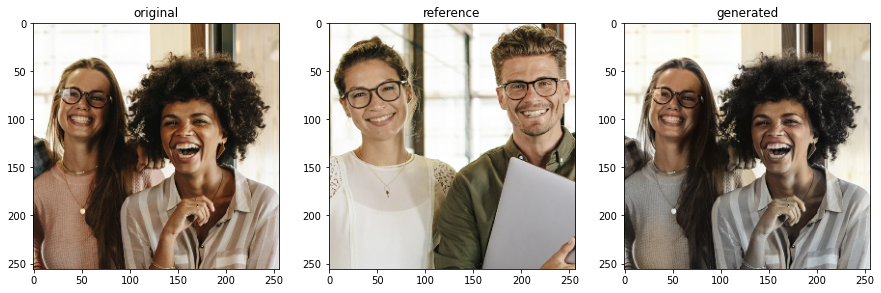

In [ ]:
test_model("test_images/image3.jpeg", "test_images/image1.jpeg")

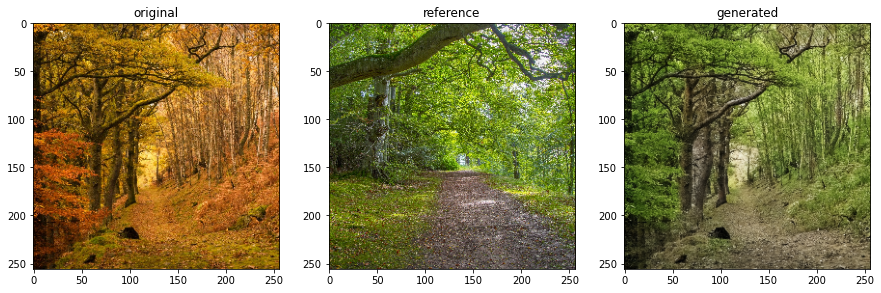

In [ ]:
test_model("test_images/image6.jpeg", "test_images/image9.jpeg")

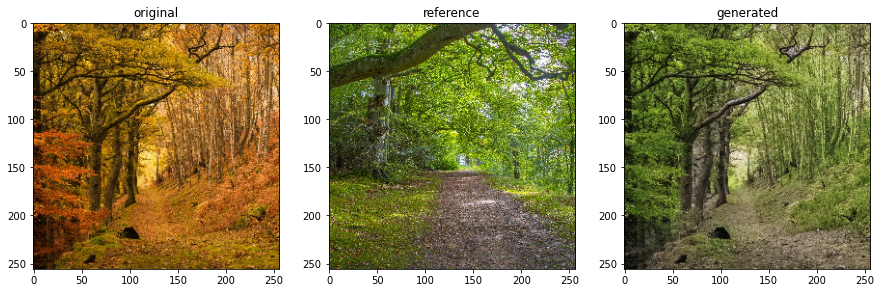

In [ ]:
test_model("test_images/image6.jpeg", "test_images/image9.jpeg") #old

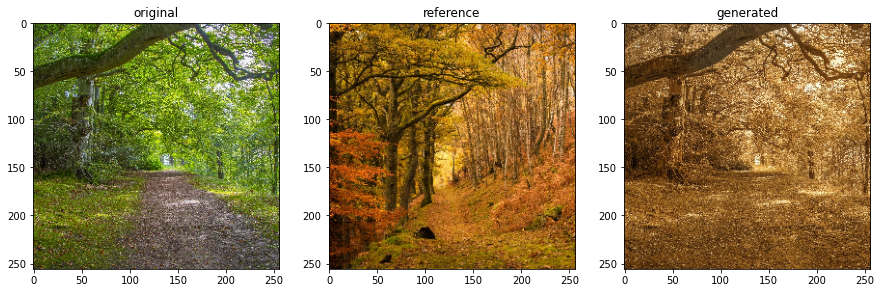

In [ ]:
test_model("test_images/image9.jpeg", "test_images/image6.jpeg") 

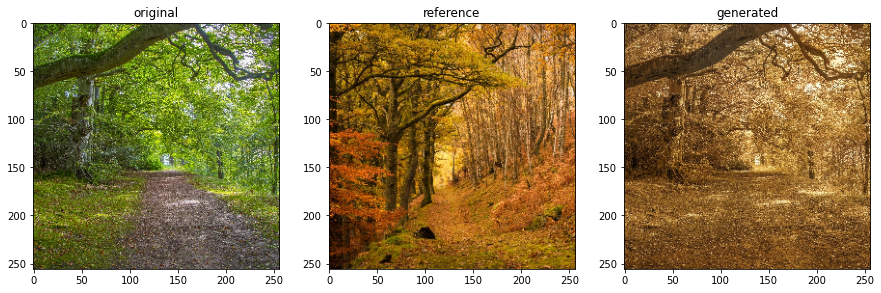

In [ ]:
test_model("test_images/image9.jpeg", "test_images/image6.jpeg") #old

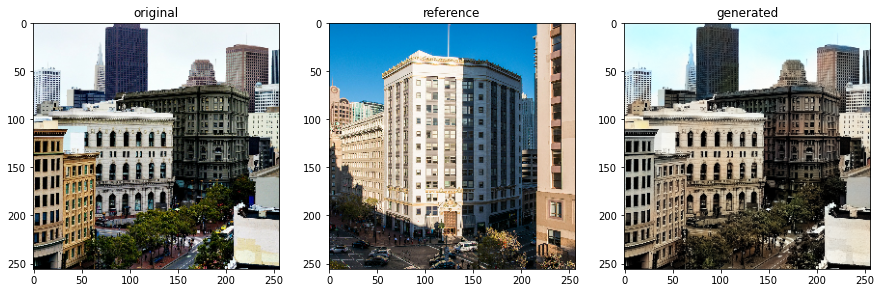

In [ ]:
test_model("test_images/image10.jpeg", "test_images/image11.jpeg")

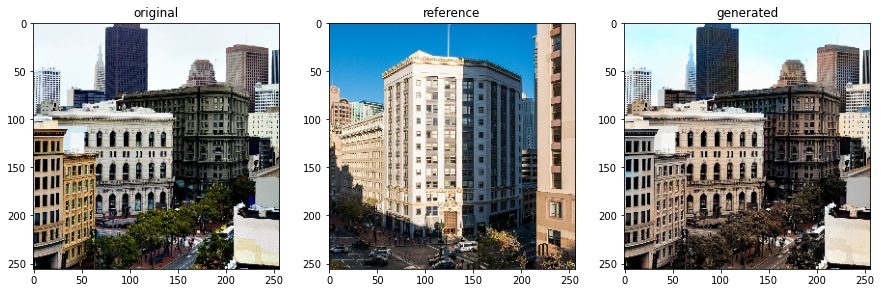

In [ ]:
test_model("test_images/image10.jpeg", "test_images/image11.jpeg") #old

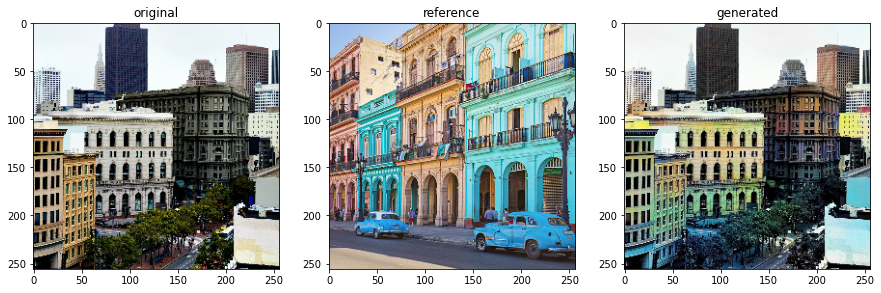

In [ ]:
test_model("test_images/image10.jpeg", "test_images/image12.jpeg")

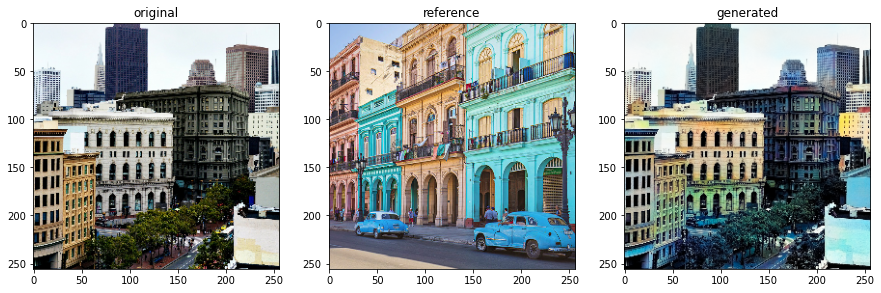

In [ ]:
test_model("test_images/image10.jpeg", "test_images/image12.jpeg") #old

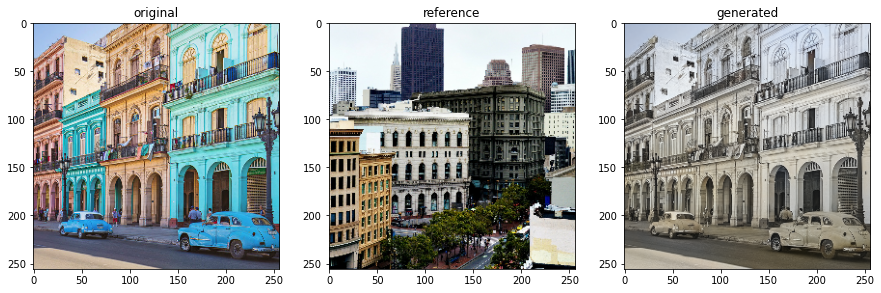

In [ ]:
test_model("test_images/image12.jpeg", "test_images/image10.jpeg")

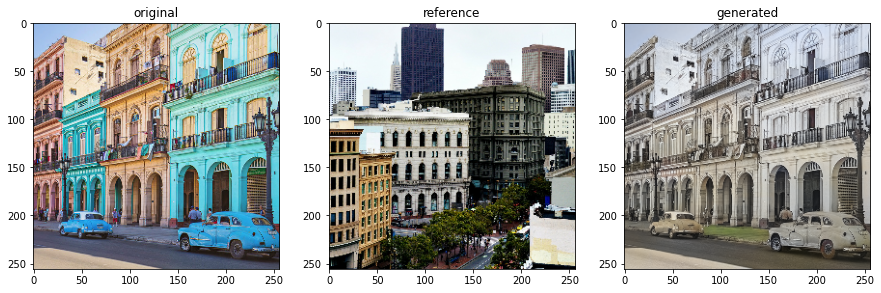

In [ ]:
test_model("test_images/image12.jpeg", "test_images/image10.jpeg") #old

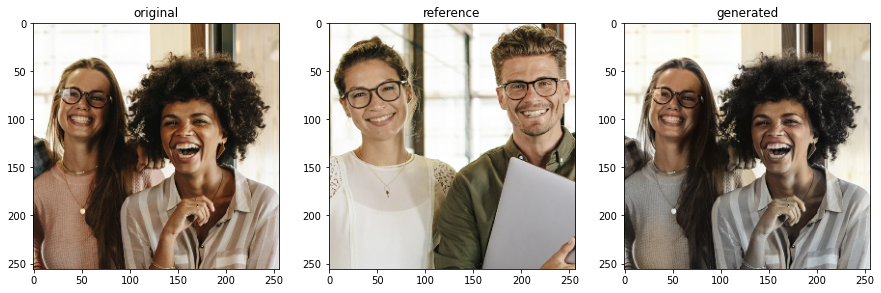

In [ ]:
test_model("test_images/image3.jpeg", "test_images/image1.jpeg")

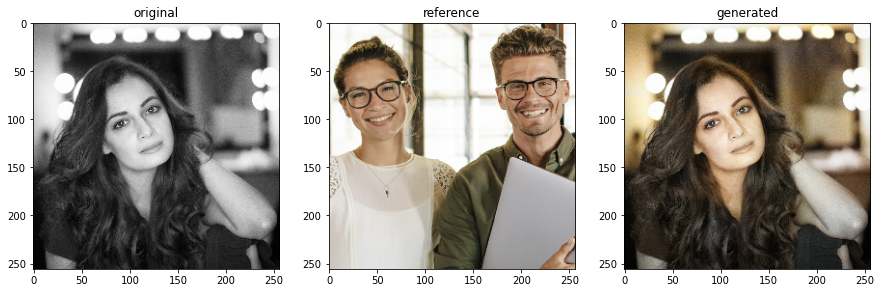

In [ ]:
test_model("test_images/image13.jpeg", "test_images/image1.jpeg")

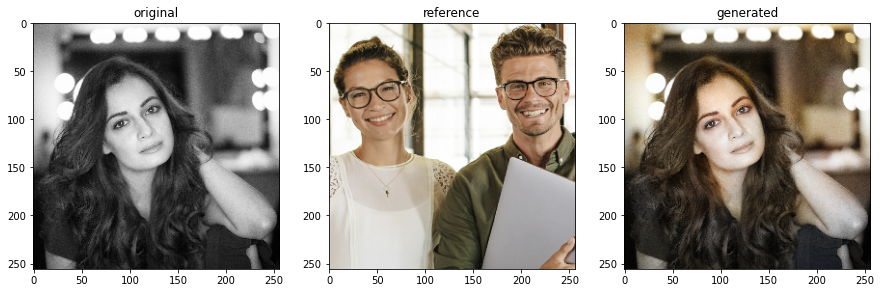

In [ ]:
test_model("test_images/image13.jpeg", "test_images/image1.jpeg") #old

# Use

In [ ]:
import gc

In [ ]:
# del test_model
tf.keras.backend.clear_session()
gc.collect()

2502

In [ ]:
# del main_model
del vgg

In [ ]:
!unzip -q Color2Style.zip

In [ ]:
!cd Color2Style && python train.py --epochs=1

2021-10-04 04:18:12.353808: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-10-04 04:18:12.363625: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-10-04 04:18:12.364521: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-10-04 04:18:12.365899: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-10-04 04:18:12.366891: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from S

In [ ]:
# !mv data Color2Style